# Sales Report Suspiciousness Detection : EDA using visualizations


## Problem Description
Classification of reports to different level of Suspiciousness, based on underlying relationship of ProductID & SalesmanID to be used for sales and productivity analysis.


### Business goal
Flag transactions as Suspicious with absolute certainty, to take corrective actions.


### Analysis Objectives

To develop an error/fraud detection software, you are required to develop a method to determine suspicious transactions which have high propensity to be error/fraud. The goal is to verify the veracity of these reports given past experience of the company that has detected both errors and fraud attempts in these transaction reports.

We are expected to create an analytical and modeling framework to predict the propensity of suspicious transaction of each report

### Data Set Description

Data consists of the transaction reports submitted by the salesmen which includes  the salesman ID, report ID, product ID, the quantity and the total value reported by the salesman.


### Algorithm Class

Multi-Class Classification.


### Main Tasks
1. To do exploratory Data Analysis using visualizations
2. Predicting the suspicious transactions using retail salesmen reports analysis (build the analytical framework to predict the propensity of suspicious transaction of each report using the transactions took place.)
3. Salesmen Segmentation (segment the salesmen into different risk categories from the standpoint of propensity to error/fraud which will be used for strategic purposes )

___This Notebook addresses to Taks1 : To do exploratory Data Analysis using visualizations___

## Import libraries

In [1]:
import pandas as pd
from IPython.core.interactiveshell import InteractiveShell
import warnings
import os
import random
import matplotlib.pyplot as plt     
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from scipy.stats import chi2_contingency
from scipy.stats import chi2
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import numpy as np
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from imblearn.pipeline import Pipeline as impipe
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import ShuffleSplit
from sklearn.metrics import roc_curve, auc, accuracy_score,classification_report, recall_score,precision_score,precision_recall_curve,average_precision_score, silhouette_score,roc_curve, auc,confusion_matrix,mean_absolute_error,mean_squared_error,roc_auc_score,f1_score, precision_recall_fscore_support
from sklearn.model_selection import learning_curve
import graphviz
from sklearn import tree
import plotly.plotly as py
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot, plot
import math 
from xgboost.sklearn import  XGBClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
import graphviz 
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import FeatureUnion
from sklearn.impute import SimpleImputer
from sklearn.metrics import make_scorer, fbeta_score, recall_score
from sklearn.preprocessing import LabelBinarizer
from statsmodels.graphics.gofplots import qqplot
import statsmodels.api as sm


## Set Environment for Execution

In [2]:
def set_env_var():
    InteractiveShell.ast_node_interactivity = "all"
    warnings.filterwarnings('ignore')
    os.environ['KMP_DUPLICATE_LIB_OK']='True'
    pd.set_option('display.max_rows', 60)
    pd.set_option('display.max_columns', 60)
    init_notebook_mode(connected=True)
    %matplotlib inline


set_env_var()


## Set Seed for consistent execution

In [3]:
def set_seed(seed=707):
    return random.seed(seed)

seed_constant = 122
set_seed(seed_constant)


## Import required data 

In [4]:
def data_importer_xlsx(data_path, na_values=[]):
    dataF = pd.read_excel(data_path, na_values=na_values)
    print("The number of Rows in the Data set  = "+str(dataF.shape[0]))
    print("The number of Columns in the data set = " +str(dataF.shape[1]))
    return dataF

salesReportData=data_importer_xlsx("/Users/samyam/Documents/Samya/GIT/insofe/Final_PHD/PHD_TrainData_and_ProblemStatement_actual/Train.xlsx")

The number of Rows in the Data set  = 42582
The number of Columns in the data set = 6


## Split data for analysis

In [6]:
salesReportDataTrain, salesReportDataTest = train_test_split(salesReportData, test_size=0.25, random_state=seed_constant, stratify=salesReportData['Suspicious'])

print("Train Set shape :",salesReportDataTrain.shape)
print("Test Set shape :",salesReportDataTest.shape)

Train Set shape : (31936, 6)
Test Set shape : (10646, 6)


## Feature Analysis of given data

In [7]:
def data_description(dataF):
    print("The columns in the data set are : \n",list(dataF.columns))
    print("The data types of the columns are :\n\n",dataF.dtypes)
    
data_description(salesReportDataTrain)

The columns in the data set are : 
 ['ReportID', 'SalesPersonID', 'ProductID', 'Quantity', 'TotalSalesValue', 'Suspicious']
The data types of the columns are :

 ReportID           object
SalesPersonID      object
ProductID          object
Quantity            int64
TotalSalesValue     int64
Suspicious         object
dtype: object


### Check the first and last 5 rows in dataset to get an understanding of data

In [8]:
salesReportDataTrain.head()
salesReportDataTrain.tail()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious
4411,Rep14512,C22230,PR6246,104,1250,indeterminate
268,Rep10369,C21820,PR6165,410,3555,indeterminate
21330,Rep31431,C21179,PR6282,2756,8270,indeterminate
35509,Rep45610,C21453,PR6299,38182,223045,indeterminate
31373,Rep41474,C22267,PR6595,100,1148,No


,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious
12782,Rep22883,C21178,PR6358,3446,3730,indeterminate
13866,Rep23967,C22322,PR6210,188,2675,indeterminate
35245,Rep45346,C21483,PR6360,300,8500,indeterminate
1063,Rep11164,C21976,PR6235,106,1005,indeterminate
17992,Rep28093,C22263,PR6492,1307,3845,indeterminate


### Random Sample rows

In [9]:
def get_data_sample(dataF, num_sample=10):
    return pd.DataFrame(dataF.sample(num_sample))

get_data_sample(salesReportDataTrain)

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious
16042,Rep26143,C21850,PR6321,138,3005,indeterminate
14251,Rep24352,C21469,PR6326,173,4045,indeterminate
27663,Rep37764,C22073,PR6678,1206,10275,indeterminate
31161,Rep41262,C21436,PR6365,143,2440,indeterminate
17028,Rep27129,C21145,PR6399,227,5875,No
7223,Rep17324,C21175,PR6227,641,4225,indeterminate
19073,Rep29174,C21862,PR6526,1779,5810,indeterminate
38337,Rep48438,C21732,PR6635,109,3650,indeterminate
18061,Rep28162,C21151,PR6184,1008,19480,indeterminate
31065,Rep41166,C21575,PR6395,103,2045,indeterminate


### Distribution of target attribute

indeterminate    29884
No                1916
Yes                136
Name: Suspicious, dtype: int64
indeterminate    93.574649
No                5.999499
Yes               0.425852
Name: Suspicious, dtype: float64


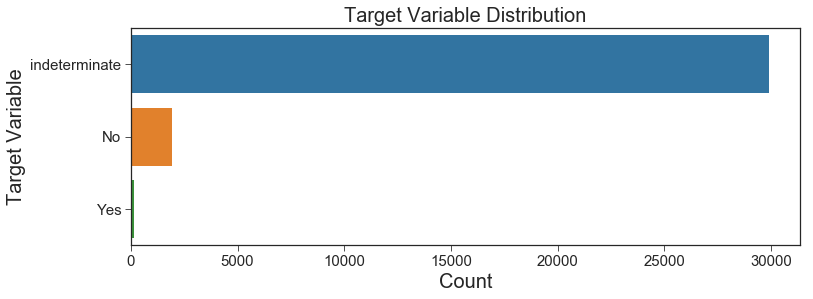

In [10]:
def plot_data_dist_across_targ(dataF, target):
    """
    Plot target variable distribution
    """
    
    print(dataF[target].value_counts())
    print((dataF[target].value_counts()/dataF[target].count())*100)
    
    plt.figure(figsize=(12,4))
    plt.style.use('seaborn-ticks')
    plot_1 = sns.countplot(y=target, data=dataF, order = dataF[target].value_counts().index);
    plot_1.axes.set_title("Target Variable Distribution",fontsize=20);
    plot_1.set_xlabel("Count",fontsize=20);
    plot_1.set_ylabel("Target Variable",fontsize=20);
    plot_1.tick_params(labelsize=15);
    plt.show();

    
plot_data_dist_across_targ(salesReportDataTrain, "Suspicious")

### Check count of null in each column & its percent

In [11]:
def get_null_count_per_attribute(dataF): 
    return pd.DataFrame({'total_missing': dataF.isnull().sum(), 
                         'perc_missing': (dataF.isnull().sum()/dataF.shape[0])*100}).sort_values(
        by=['perc_missing'], ascending=False)

get_null_count_per_attribute(salesReportDataTrain)

,total_missing,perc_missing
ReportID,0,0.0
SalesPersonID,0,0.0
ProductID,0,0.0
Quantity,0,0.0
TotalSalesValue,0,0.0
Suspicious,0,0.0


### Check for count of unique values in different attriutes

In [12]:
def get_unique_value_count_per_attribute(dataF): 
    return pd.DataFrame((dataF.nunique()/dataF.shape[0])*100).rename(
        {0: 'perc_unique'}, axis=1).sort_values(by=['perc_unique'])

get_unique_value_count_per_attribute(salesReportDataTrain)

,perc_unique
Suspicious,0.009394
ProductID,1.847445
SalesPersonID,3.087425
Quantity,17.422345
TotalSalesValue,20.916834
ReportID,100.000000


### Distribution of Quantify and TotalSalesValue across Suspicious level   

In [13]:
salesReportDataTrain_var_acr_Sus_lev = pd.pivot_table(
    salesReportDataTrain, values=['Quantity', 'TotalSalesValue'], index=['ProductID'], 
            columns=['Suspicious'], aggfunc={'Quantity': np.sum,'TotalSalesValue': np.sum})
salesReportDataTrain_var_acr_Sus_lev.head()

Quantity                       TotalSalesValue            \
Suspicious         No     Yes indeterminate              No       Yes   
ProductID                                                               
PR6112            NaN     NaN       79675.0             NaN       NaN   
PR6113            NaN     NaN        2485.0             NaN       NaN   
PR6114            NaN     NaN      248494.0             NaN       NaN   
PR6115      1211928.0  6728.0      665206.0       5745680.0  155705.0   
PR6116       213375.0   200.0      142697.0       1185230.0   11060.0   

                          
Suspicious indeterminate  
ProductID                 
PR6112          867970.0  
PR6113           92555.0  
PR6114          789600.0  
PR6115         3552200.0  
PR6116          933035.0

In [14]:
salesReportDataTrain_var_acr_Sus_lev_1 = salesReportDataTrain_var_acr_Sus_lev['TotalSalesValue']/salesReportDataTrain_var_acr_Sus_lev['Quantity']
salesReportDataTrain_var_acr_Sus_lev_1.head()

Suspicious,No,Yes,indeterminate
ProductID,,,
PR6112,NaN,NaN,10.893881
PR6113,NaN,NaN,37.245473
PR6114,NaN,NaN,3.177542
PR6115,4.740942,23.142836,5.340000
PR6116,5.554681,55.300000,6.538575


In [15]:
#Check for Products Suspicious='YES' only
data_sample = salesReportDataTrain_var_acr_Sus_lev_1[salesReportDataTrain_var_acr_Sus_lev_1['Yes'].notnull()]

trace_yes = go.Bar(x=data_sample.index ,
                  y= data_sample.Yes,
                  name = 'Yes')
trace_no = go.Bar(x=data_sample.index ,
                  y= data_sample.No,
                  name = 'No')
trace_indeterminate = go.Bar(x=data_sample.index ,
                  y= data_sample.indeterminate,
                  name = 'indeterminate')

layout = go.Layout(title = 'Distribution of Average TotalSalesValue across Suspicious level',
                  xaxis = dict(title = 'ProductID'),
                  yaxis = dict(title = 'Average TotalSalesValue'))

data = [trace_yes, trace_no, trace_indeterminate]

fig = go.Figure(data=data, layout=layout)
iplot(fig)


__Observation__
1. We can observe that the Average TotalSalesValue is either very high or very low for Suspicious = Yes. 

### Generate SalesValuePerItem column

In [16]:
# SalesValuePerItem, represents selling price of each ProductID for a given report
salesReportDataTrain_feature_added = salesReportDataTrain.copy()
salesReportDataTrain_feature_added.insert(4, 'SalesValuePerItem', 
                                          salesReportDataTrain_feature_added['TotalSalesValue']/salesReportDataTrain_feature_added['Quantity'])
salesReportDataTrain_feature_added.head()


,ReportID,SalesPersonID,ProductID,Quantity,SalesValuePerItem,TotalSalesValue,Suspicious
4411,Rep14512,C22230,PR6246,104,12.019231,1250,indeterminate
268,Rep10369,C21820,PR6165,410,8.670732,3555,indeterminate
21330,Rep31431,C21179,PR6282,2756,3.000726,8270,indeterminate
35509,Rep45610,C21453,PR6299,38182,5.841627,223045,indeterminate
31373,Rep41474,C22267,PR6595,100,11.480000,1148,No


### Identify Suspicious SalesPersonID

In [17]:
# Identify Suspicious SalesPersonID, based on frequency of fault
salesReportDataTrain_feature_added_by_SalesPersonID_1 = salesReportDataTrain_feature_added[
    ['SalesPersonID', 'Suspicious']].groupby(['SalesPersonID']).apply(
    lambda x: (x['Suspicious']== 'Yes').sum()).reset_index(name='countOfSuspiciousEQYesPerGrp')

salesReportDataTrain_feature_added_by_SalesPersonID_2 = salesReportDataTrain_feature_added[
    ['SalesPersonID', 'Suspicious']].groupby(['SalesPersonID']).count().reset_index().rename(
    columns={'Suspicious':'countOfSuspiciousPerGrp'})

salesReportDataTrain_feature_added_by_SalesPersonID_3 = salesReportDataTrain_feature_added_by_SalesPersonID_1.merge(
    salesReportDataTrain_feature_added_by_SalesPersonID_2, on='SalesPersonID', how='outer')

salesReportDataTrain_feature_added_by_SalesPersonID_3['percOfSuspiciousEQYes'] = (
    salesReportDataTrain_feature_added_by_SalesPersonID_3['countOfSuspiciousEQYesPerGrp']
    /salesReportDataTrain_feature_added_by_SalesPersonID_3['countOfSuspiciousPerGrp'])*100

salesReportDataTrain_feature_added_by_SalesPersonID_3.sort_values(['percOfSuspiciousEQYes'], ascending=[0]).head()

,SalesPersonID,countOfSuspiciousEQYesPerGrp,countOfSuspiciousPerGrp,percOfSuspiciousEQYes
556,C21818,1,1,100.000000
598,C21870,1,3,33.333333
626,C21901,1,4,25.000000
428,C21652,1,4,25.000000
599,C21871,1,4,25.000000


### Identify Suspicious ProductID

In [18]:
# Identify Suspicious ProductID, based on frequency of fault
salesReportDataTrain_feature_added_by_ProductID_1 = salesReportDataTrain_feature_added[
    ['ProductID', 'Suspicious']].groupby(
    ['ProductID']).apply(lambda x: (x['Suspicious']== 'Yes').sum()).reset_index(
    name='countOfSuspiciousEQYesPerGrp')

salesReportDataTrain_feature_added_by_ProductID_2 = salesReportDataTrain_feature_added[
    ['ProductID', 'Suspicious']].groupby(
    ['ProductID']).count().reset_index().rename(columns={'Suspicious':'countOfSuspiciousPerGrp'})

salesReportDataTrain_feature_added_by_ProductID_3 = salesReportDataTrain_feature_added_by_ProductID_1.merge(
    salesReportDataTrain_feature_added_by_ProductID_2, on='ProductID', how='outer')

salesReportDataTrain_feature_added_by_ProductID_3['percOfSuspiciousEQYes'] = (
    salesReportDataTrain_feature_added_by_ProductID_3['countOfSuspiciousEQYesPerGrp']/
    salesReportDataTrain_feature_added_by_ProductID_3['countOfSuspiciousPerGrp'])*100

salesReportDataTrain_feature_added_by_ProductID_3.sort_values(['percOfSuspiciousEQYes'], ascending=[0]).head()

,ProductID,countOfSuspiciousEQYesPerGrp,countOfSuspiciousPerGrp,percOfSuspiciousEQYes
401,PR6516,2,9,22.222222
436,PR6551,2,26,7.692308
397,PR6512,2,27,7.407407
545,PR6660,2,31,6.451613
31,PR6144,1,17,5.882353


__Observation__

Neither any ProductID nor any SalesPersonID have direct relation with Suspicious=YES

### Distribution of Suspicious=YES, groupby SalesPersonID and ProductID

In [19]:
salesReportDataTrain_feature_added_grp_by_SPS = salesReportDataTrain_feature_added[[
    'SalesPersonID', 'ProductID', 'Suspicious', 'SalesValuePerItem']].groupby(
    ['SalesPersonID', 'ProductID', 'Suspicious'], sort=False).mean().reset_index()

salesReportDataTrain_feature_added_grp_by_SPS_pivot = salesReportDataTrain_feature_added_grp_by_SPS.groupby(
    ['SalesPersonID', 'ProductID', 'Suspicious'])['SalesValuePerItem'].aggregate('first').unstack().rename(
    columns=str).reset_index()

# Drop any row with all the following columns NAN (indeterminate, No, Yes) 
salesReportDataTrain_feature_added_grp_by_SPS_pivot_1 = salesReportDataTrain_feature_added_grp_by_SPS_pivot.dropna(
    subset=['indeterminate', 'No', 'Yes'], how='all')
salesReportDataTrain_feature_added_grp_by_SPS_pivot_1.head()

Suspicious,SalesPersonID,ProductID,No,Yes,indeterminate
0,C21116,PR6112,NaN,NaN,9.423077
1,C21116,PR6253,NaN,NaN,12.326139
2,C21116,PR6294,NaN,NaN,15.897436
3,C21118,PR6202,2.119138,216.272727,2.012689
4,C21119,PR6253,8.644578,NaN,NaN


In [20]:
salesReportDataTrain_feature_added_grp_by_SPS_pivot_1['max_suspicious_level'] = salesReportDataTrain_feature_added_grp_by_SPS_pivot_1[['indeterminate', 'No', 'Yes']].idxmax(axis=1)
salesReportDataTrain_feature_added_grp_by_SPS_pivot_1['min_suspicious_level'] = salesReportDataTrain_feature_added_grp_by_SPS_pivot_1[['indeterminate', 'No', 'Yes']].idxmin(axis=1)
salesReportDataTrain_feature_added_grp_by_SPS_pivot_2 = salesReportDataTrain_feature_added_grp_by_SPS_pivot_1.loc[
    salesReportDataTrain_feature_added_grp_by_SPS_pivot_1['Yes'].notnull()]
salesReportDataTrain_feature_added_grp_by_SPS_pivot_2.head()

Suspicious,SalesPersonID,ProductID,No,Yes,indeterminate,max_suspicious_level,min_suspicious_level
3,C21118,PR6202,2.119138,216.272727,2.012689,Yes,indeterminate
41,C21128,PR6437,NaN,171.655791,36.270710,Yes,indeterminate
43,C21128,PR6455,3.335544,68.706815,4.053819,Yes,No
176,C21151,PR6177,7.696113,0.967989,7.448581,No,Yes
216,C21163,PR6213,3.315998,0.360723,NaN,No,Yes


In [21]:
# For SalesPersonID and ProductID group, for rows having Suspicious=YES is there a pattern ?
salesReportDataTrain_feature_added_grp_by_SPS_pivot_2[(
    salesReportDataTrain_feature_added_grp_by_SPS_pivot_2['max_suspicious_level']=='Yes') | (
    salesReportDataTrain_feature_added_grp_by_SPS_pivot_2['min_suspicious_level']=='Yes')].shape[0]


# Scenarios when Suspicious=YES, but the SalesValuePerItem is min or max for a specific 
# SalesPersonIDand ProductID group

salesReportDataTrain_feature_added_grp_by_SPS_pivot_2[(
    salesReportDataTrain_feature_added_grp_by_SPS_pivot_2['max_suspicious_level']!='Yes') & (
    salesReportDataTrain_feature_added_grp_by_SPS_pivot_2['min_suspicious_level']!='Yes')].shape[0]

salesReportDataTrain_feature_added_grp_by_SPS_pivot_2[(
    salesReportDataTrain_feature_added_grp_by_SPS_pivot_2['max_suspicious_level']!='Yes') & (
    salesReportDataTrain_feature_added_grp_by_SPS_pivot_2['min_suspicious_level']!='Yes')]

118

3

Suspicious,SalesPersonID,ProductID,No,Yes,indeterminate,max_suspicious_level,min_suspicious_level
701,C21220,PR6595,0.426001,0.830140,15.276936,indeterminate,No
3489,C21829,PR6182,19.476800,23.366337,23.559797,indeterminate,No
5876,C22220,PR6253,10.700679,11.216000,16.964321,indeterminate,No


__Observations__
1. There can be scenarios when the Suspicious=YES, but the SalesValuePerItem is __NOT__ min or max for a specific SalesPersonID and ProductID group

In [22]:
salesReportDataTrain_feature_added_grp_by_SPS_pivot_1['ProductID_SalesPersonID'] = salesReportDataTrain_feature_added_grp_by_SPS_pivot_1[['ProductID', 'SalesPersonID']].apply(lambda x: '_'.join(x), axis=1)
data_sample = salesReportDataTrain_feature_added_grp_by_SPS_pivot_1


trace_yes = go.Scatter(x=data_sample.ProductID_SalesPersonID ,
                  y= data_sample.Yes,
                  name = 'Yes',
                  mode= 'markers')
trace_no = go.Scatter(x=data_sample.ProductID_SalesPersonID ,
                  y= data_sample.No,
                  name = 'No',
                  mode= 'markers')
trace_indeterminate = go.Scatter(x=data_sample.ProductID_SalesPersonID ,
                  y= data_sample.indeterminate,
                  name = 'indeterminate',
                  mode= 'markers')

layout = go.Layout(title = 'Distribution of Avg TotalSalesValue across Suspicious level, groupby ProductID and SalesPersonID',
                  xaxis = dict(title = 'ProductID_SalesPersonID',titlefont=dict(size=10), tickfont=dict(size=7)),
                  yaxis = dict(title = 'Average TotalSalesValue for each Suspicious level',titlefont=dict(size=10)))

data = [trace_yes, trace_no, trace_indeterminate]

fig = go.Figure(data=data, layout=layout)
iplot(fig)


### Generate more features & observe relation to target label

#### Get per unit selleing price for a transaction

In [23]:
salesReportDataTrain_feature_added = salesReportDataTrain.copy()
salesReportDataTrain_feature_added.insert(5, 'SalesValuePerItem', 
                                          salesReportDataTrain_feature_added['TotalSalesValue']/salesReportDataTrain_feature_added['Quantity'])
salesReportDataTrain_feature_added.head()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious
4411,Rep14512,C22230,PR6246,104,1250,12.019231,indeterminate
268,Rep10369,C21820,PR6165,410,3555,8.670732,indeterminate
21330,Rep31431,C21179,PR6282,2756,8270,3.000726,indeterminate
35509,Rep45610,C21453,PR6299,38182,223045,5.841627,indeterminate
31373,Rep41474,C22267,PR6595,100,1148,11.480000,No


#### Get per unit selling price for across all transactions for a products

In [24]:
salesReportDataTrain_grp_productID = salesReportDataTrain_feature_added.groupby('ProductID').agg(
    {'TotalSalesValue':'sum','Quantity':'sum'}).reset_index().rename(columns={
    'TotalSalesValue':'TotalSalesValueByProduct',
    'Quantity':'QuantityByProduct'
})
salesReportDataTrain_grp_productID['AverageSalesValueByProduct'] = salesReportDataTrain_grp_productID['TotalSalesValueByProduct']/salesReportDataTrain_grp_productID['QuantityByProduct']
salesReportDataTrain_grp_productID.head()


,ProductID,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct
0,PR6112,867970,79675,10.893881
1,PR6113,92555,2485,37.245473
2,PR6114,789600,248494,3.177542
3,PR6115,9453585,1883862,5.018194
4,PR6116,2129325,356272,5.976684


In [25]:
# Append the AverageSalesValueByProduct to dataset
salesReportDataTrain_add_feature_grp_P = salesReportDataTrain_feature_added.merge(
    salesReportDataTrain_grp_productID, on='ProductID', how='outer')
salesReportDataTrain_add_feature_grp_P.head()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct
0,Rep14512,C22230,PR6246,104,1250,12.019231,indeterminate,172910,26911,6.425254
1,Rep14509,C22230,PR6246,119,5515,46.344538,indeterminate,172910,26911,6.425254
2,Rep23272,C21899,PR6246,389,3550,9.125964,indeterminate,172910,26911,6.425254
3,Rep12698,C21284,PR6246,101,1300,12.871287,indeterminate,172910,26911,6.425254
4,Rep12681,C21284,PR6246,102,1075,10.539216,indeterminate,172910,26911,6.425254


In [26]:
#Check for Products Suspicious='YES' only
data_sample = salesReportDataTrain_add_feature_grp_P[salesReportDataTrain_add_feature_grp_P['Suspicious']=='Yes'].sample(10)

trace_SalesValuePerItem = go.Bar(x=data_sample.ReportID ,
                  y= data_sample.SalesValuePerItem,
                  name = 'SalesValuePerItem')
trace_TotalSalesValueByProduct = go.Bar(x=data_sample.ReportID ,
                  y= data_sample.AverageSalesValueByProduct,
                  name = 'AverageSalesValueByProduct')


layout = go.Layout(title = 'Distribution of SalesValuePerItem per transaction vs AverageSalesValueByProduct (For Suspicious=YES)',
                  xaxis = dict(title = 'ReportID', tickangle = -45),
                  yaxis = dict(title = 'Average TotalSalesValue By Product'))

data = [trace_SalesValuePerItem, trace_TotalSalesValueByProduct]

fig = go.Figure(data=data, layout=layout)
iplot(fig)




#Check for Products Suspicious='No' only
data_sample = salesReportDataTrain_add_feature_grp_P[salesReportDataTrain_add_feature_grp_P['Suspicious']=='No'].sample(10)

trace_SalesValuePerItem = go.Bar(x=data_sample.ReportID ,
                  y= data_sample.SalesValuePerItem,
                  name = 'SalesValuePerItem')
trace_TotalSalesValueByProduct = go.Bar(x=data_sample.ReportID ,
                  y= data_sample.AverageSalesValueByProduct,
                  name = 'AverageSalesValueByProduct')


layout = go.Layout(title = 'Distribution of SalesValuePerItem per transaction vs AverageSalesValueByProduct (For Suspicious=NO)',
                  xaxis = dict(title = 'ReportID', tickangle = -45),
                  yaxis = dict(title = 'Average TotalSalesValue By Product'))

data = [trace_SalesValuePerItem, trace_TotalSalesValueByProduct]

fig = go.Figure(data=data, layout=layout)
iplot(fig)



#Check for Products Suspicious='indeterminate' only
data_sample = salesReportDataTrain_add_feature_grp_P[salesReportDataTrain_add_feature_grp_P['Suspicious']=='indeterminate'].sample(10)

trace_SalesValuePerItem = go.Bar(x=data_sample.ReportID ,
                  y= data_sample.SalesValuePerItem,
                  name = 'SalesValuePerItem')
trace_TotalSalesValueByProduct = go.Bar(x=data_sample.ReportID ,
                  y= data_sample.AverageSalesValueByProduct,
                  name = 'AverageSalesValueByProduct')


layout = go.Layout(title = 'Distribution of SalesValuePerItem per transaction vs AverageSalesValueByProduct (For Suspicious=indeterminate)',
                  xaxis = dict(title = 'ReportID', tickangle = -45),
                  yaxis = dict(title = 'Average TotalSalesValue By Product'))

data = [trace_SalesValuePerItem, trace_TotalSalesValueByProduct]

fig = go.Figure(data=data, layout=layout)
iplot(fig)


In [27]:
#### Get Deviation of SalesValuePerItem from AverageSalesValueByProduct
salesReportDataTrain_add_feature_grp_P['SalesValuePerItemVariationFromAvgProduct'] = (((salesReportDataTrain_add_feature_grp_P['AverageSalesValueByProduct'] - 
 salesReportDataTrain_add_feature_grp_P['SalesValuePerItem']).abs())/salesReportDataTrain_add_feature_grp_P['AverageSalesValueByProduct'])*100
salesReportDataTrain_add_feature_grp_P.head()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,SalesValuePerItemVariationFromAvgProduct
0,Rep14512,C22230,PR6246,104,1250,12.019231,indeterminate,172910,26911,6.425254,87.062356
1,Rep14509,C22230,PR6246,119,5515,46.344538,indeterminate,172910,26911,6.425254,621.287292
2,Rep23272,C21899,PR6246,389,3550,9.125964,indeterminate,172910,26911,6.425254,42.032744
3,Rep12698,C21284,PR6246,101,1300,12.871287,indeterminate,172910,26911,6.425254,100.323410
4,Rep12681,C21284,PR6246,102,1075,10.539216,indeterminate,172910,26911,6.425254,64.028011


In [28]:
data = []
for i in range(0,len(pd.unique(salesReportDataTrain_add_feature_grp_P['Suspicious']))):
    trace = {
            "type": 'violin',
            "x": salesReportDataTrain_add_feature_grp_P['Suspicious'][salesReportDataTrain_add_feature_grp_P['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P['Suspicious'])[i]],
            "y": salesReportDataTrain_add_feature_grp_P['SalesValuePerItemVariationFromAvgProduct'][salesReportDataTrain_add_feature_grp_P['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P['Suspicious'])[i]],
            "name": pd.unique(salesReportDataTrain_add_feature_grp_P['Suspicious'])[i],
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            }
        }
    data.append(trace)

        
fig = {
    "data": data,
    "layout" : {
        "title": "Distribution of SalesValuePerItem per transaction vs AverageSalesValueByProduct",
        "yaxis": {
            "zeroline": False,
        }
    }
}

iplot(fig)


__Observation__
1. The per item selling price of a given product ina transaction is either way less or more than the averege sellinging price of the product across all transactions for Suspicious=YES.
2. The above statements are not true for Suspicious=No or Suspicious=indeterminate
3. Average deviation of selling price of per product for Suspicious=Yes is way high as compared to Suspicious=No & Suspicious=indeterminate

#### Quantity of sales to Suspicious label relation
Is overall Quantity of of sale of a product related to quantity of sale of product in the current transaction?

In [29]:
salesReportDataTrain_add_feature_grp_P['perc_Quantity_by_Product'] = (
    salesReportDataTrain_add_feature_grp_P['Quantity']/salesReportDataTrain_add_feature_grp_P['QuantityByProduct'])*100
salesReportDataTrain_add_feature_grp_P.head()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product
0,Rep14512,C22230,PR6246,104,1250,12.019231,indeterminate,172910,26911,6.425254,87.062356,0.386459
1,Rep14509,C22230,PR6246,119,5515,46.344538,indeterminate,172910,26911,6.425254,621.287292,0.442198
2,Rep23272,C21899,PR6246,389,3550,9.125964,indeterminate,172910,26911,6.425254,42.032744,1.445506
3,Rep12698,C21284,PR6246,101,1300,12.871287,indeterminate,172910,26911,6.425254,100.323410,0.375311
4,Rep12681,C21284,PR6246,102,1075,10.539216,indeterminate,172910,26911,6.425254,64.028011,0.379027


In [30]:
data = []
for i in range(0,len(pd.unique(salesReportDataTrain_add_feature_grp_P['Suspicious']))):
    trace = {
            "type": 'violin',
            "x": salesReportDataTrain_add_feature_grp_P['Suspicious'][salesReportDataTrain_add_feature_grp_P['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P['Suspicious'])[i]],
            "y": salesReportDataTrain_add_feature_grp_P['perc_Quantity_by_Product'][salesReportDataTrain_add_feature_grp_P['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P['Suspicious'])[i]],
            "name": pd.unique(salesReportDataTrain_add_feature_grp_P['Suspicious'])[i],
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            }
        }
    data.append(trace)

        
fig = {
    "data": data,
    "layout" : {
        "title": "Distribution of % variation in Quantity per transaction vs Total Quantity Group By Product",
        "yaxis": {
            "zeroline": False,
        }
    }
}

iplot(fig)


__Observation__
1. When the Suspicious=Yes, the mean quantity percentage, sold tends to be much higher than the two other cases.

#### Get total Quantity sold, TotalSalesBySalesMan, AverageSalesValueBySalesMan for all transactions for a SalesPersonID

In [31]:
salesReportDataTrain_grp_SalesPersonID = salesReportDataTrain_add_feature_grp_P.groupby('SalesPersonID').agg(
    {'TotalSalesValue':'sum','Quantity':'sum'}).reset_index().rename(columns={
    'TotalSalesValue':'TotalSalesValueBySalesMan',
    'Quantity':'QuantityBySalesMan'
})
salesReportDataTrain_grp_SalesPersonID['AverageSalesValueBySalesMan'] = salesReportDataTrain_grp_SalesPersonID['TotalSalesValueBySalesMan']/salesReportDataTrain_grp_SalesPersonID['QuantityBySalesMan']
salesReportDataTrain_grp_SalesPersonID.head()


,SalesPersonID,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan
0,C21116,15820,1288,12.282609
1,C21118,1583390,764085,2.072269
2,C21119,3665,368,9.959239
3,C21121,166590,12926,12.887978
4,C21122,31405,3569,8.799384


In [32]:
# Append the AverageSalesValueByProduct to dataset
salesReportDataTrain_add_feature_grp_P_S = salesReportDataTrain_add_feature_grp_P.merge(
    salesReportDataTrain_grp_SalesPersonID, on='SalesPersonID', how='outer')
salesReportDataTrain_add_feature_grp_P_S.head()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan
0,Rep14512,C22230,PR6246,104,1250,12.019231,indeterminate,172910,26911,6.425254,87.062356,0.386459,546690,106552,5.130734
1,Rep14509,C22230,PR6246,119,5515,46.344538,indeterminate,172910,26911,6.425254,621.287292,0.442198,546690,106552,5.130734
2,Rep14507,C22230,PR6246,133,4975,37.406015,indeterminate,172910,26911,6.425254,482.171807,0.494222,546690,106552,5.130734
3,Rep14510,C22230,PR6246,193,4550,23.575130,indeterminate,172910,26911,6.425254,266.913603,0.717179,546690,106552,5.130734
4,Rep14516,C22230,PR6115,685,5270,7.693431,indeterminate,9453585,1883862,5.018194,53.310746,0.036361,546690,106552,5.130734


In [33]:
#### Get Deviation of SalesValuePerItem from AverageSalesValueBySalesMan
salesReportDataTrain_add_feature_grp_P_S['SalesValuePerItemVariationFromAvgSalesMan'] = (((salesReportDataTrain_add_feature_grp_P_S['AverageSalesValueBySalesMan'] - 
 salesReportDataTrain_add_feature_grp_P_S['SalesValuePerItem']).abs())/salesReportDataTrain_add_feature_grp_P_S['AverageSalesValueBySalesMan'])*100
salesReportDataTrain_add_feature_grp_P_S.head()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,SalesValuePerItemVariationFromAvgSalesMan
0,Rep14512,C22230,PR6246,104,1250,12.019231,indeterminate,172910,26911,6.425254,87.062356,0.386459,546690,106552,5.130734,134.259466
1,Rep14509,C22230,PR6246,119,5515,46.344538,indeterminate,172910,26911,6.425254,621.287292,0.442198,546690,106552,5.130734,803.273005
2,Rep14507,C22230,PR6246,133,4975,37.406015,indeterminate,172910,26911,6.425254,482.171807,0.494222,546690,106552,5.130734,629.057732
3,Rep14510,C22230,PR6246,193,4550,23.575130,indeterminate,172910,26911,6.425254,266.913603,0.717179,546690,106552,5.130734,359.488412
4,Rep14516,C22230,PR6115,685,5270,7.693431,indeterminate,9453585,1883862,5.018194,53.310746,0.036361,546690,106552,5.130734,49.947946


In [34]:
data = []
for i in range(0,len(pd.unique(salesReportDataTrain_add_feature_grp_P_S['Suspicious']))):
    trace = {
            "type": 'violin',
            "x": salesReportDataTrain_add_feature_grp_P_S['Suspicious'][salesReportDataTrain_add_feature_grp_P_S['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P_S['Suspicious'])[i]],
            "y": salesReportDataTrain_add_feature_grp_P_S['SalesValuePerItemVariationFromAvgSalesMan'][salesReportDataTrain_add_feature_grp_P_S['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P_S['Suspicious'])[i]],
            "name": pd.unique(salesReportDataTrain_add_feature_grp_P_S['Suspicious'])[i],
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            }
        }
    data.append(trace)

        
fig = {
    "data": data,
    "layout" : {
        "title": "Distribution of % variation in SalesValuePerItem per transaction vs AverageSalesValueBySalesMan",
        "yaxis": {
            "zeroline": False,
        }
    }
}

iplot(fig)


__Observation__

1. Average deviation of selling price of per SalesPersonID for Suspicious=Yes is way high as compared to Suspicious=No & Suspicious=indeterminate

#### Quantity of sales to Suspicious label relation
Is overall Quantity of of sale of a product related to quantity of sale of product in the current transaction?

In [35]:
salesReportDataTrain_add_feature_grp_P_S['perc_Quantity_by_SalesMan'] = (
    salesReportDataTrain_add_feature_grp_P_S['Quantity']/salesReportDataTrain_add_feature_grp_P_S['QuantityBySalesMan'])*100
salesReportDataTrain_add_feature_grp_P_S.head()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,SalesValuePerItemVariationFromAvgSalesMan,perc_Quantity_by_SalesMan
0,Rep14512,C22230,PR6246,104,1250,12.019231,indeterminate,172910,26911,6.425254,87.062356,0.386459,546690,106552,5.130734,134.259466,0.097605
1,Rep14509,C22230,PR6246,119,5515,46.344538,indeterminate,172910,26911,6.425254,621.287292,0.442198,546690,106552,5.130734,803.273005,0.111683
2,Rep14507,C22230,PR6246,133,4975,37.406015,indeterminate,172910,26911,6.425254,482.171807,0.494222,546690,106552,5.130734,629.057732,0.124822
3,Rep14510,C22230,PR6246,193,4550,23.575130,indeterminate,172910,26911,6.425254,266.913603,0.717179,546690,106552,5.130734,359.488412,0.181132
4,Rep14516,C22230,PR6115,685,5270,7.693431,indeterminate,9453585,1883862,5.018194,53.310746,0.036361,546690,106552,5.130734,49.947946,0.642879


In [36]:
data = []
for i in range(0,len(pd.unique(salesReportDataTrain_add_feature_grp_P['Suspicious']))):
    trace = {
            "type": 'violin',
            "x": salesReportDataTrain_add_feature_grp_P_S['Suspicious'][salesReportDataTrain_add_feature_grp_P_S['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P_S['Suspicious'])[i]],
            "y": salesReportDataTrain_add_feature_grp_P_S['perc_Quantity_by_SalesMan'][salesReportDataTrain_add_feature_grp_P_S['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P_S['Suspicious'])[i]],
            "name": pd.unique(salesReportDataTrain_add_feature_grp_P_S['Suspicious'])[i],
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            }
        }
    data.append(trace)

        
fig = {
    "data": data,
    "layout" : {
        "title": "Distribution of % variation in Quantity per transaction vs Total Quantity Group By SalesPersonID",
        "yaxis": {
            "zeroline": False,
        }
    }
}

iplot(fig)


__Observation__

1. There is clear distinction in mean variation from average quantity sold by a Salesman to the quantity sold in case of each Suspicious level.

#### Get total Quantity sold, total Sales Value, Average sales value for all transactions for a SalesPersonID & ProductID combination

In [37]:
salesReportDataTrain_grp_SalesPersonID_ProductID = salesReportDataTrain_add_feature_grp_P.groupby(['SalesPersonID','ProductID']).agg(
    {'TotalSalesValue':'sum','Quantity':'sum'}).reset_index().rename(columns={
    'TotalSalesValue':'TotalSalesValueBySalesManProductID',
    'Quantity':'QuantityBySalesManProductID'
})
salesReportDataTrain_grp_SalesPersonID_ProductID['AverageSalesValueBySalesManProductID'] = salesReportDataTrain_grp_SalesPersonID_ProductID['TotalSalesValueBySalesManProductID']/salesReportDataTrain_grp_SalesPersonID_ProductID['QuantityBySalesManProductID']
salesReportDataTrain_grp_SalesPersonID_ProductID.head()


,SalesPersonID,ProductID,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID
0,C21116,PR6112,5145,546,9.423077
1,C21116,PR6253,8815,625,14.104000
2,C21116,PR6294,1860,117,15.897436
3,C21118,PR6202,1583390,764085,2.072269
4,C21119,PR6253,1435,166,8.644578


In [38]:
# Append the AverageSalesValueByProduct to dataset
salesReportDataTrain_add_feature_grp_P_and_S = salesReportDataTrain_add_feature_grp_P_S.merge(
    salesReportDataTrain_grp_SalesPersonID_ProductID, on=['SalesPersonID','ProductID'], how='outer')
salesReportDataTrain_add_feature_grp_P_and_S.head()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,SalesValuePerItemVariationFromAvgSalesMan,perc_Quantity_by_SalesMan,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID
0,Rep14512,C22230,PR6246,104,1250,12.019231,indeterminate,172910,26911,6.425254,87.062356,0.386459,546690,106552,5.130734,134.259466,0.097605,16290,549,29.672131
1,Rep14509,C22230,PR6246,119,5515,46.344538,indeterminate,172910,26911,6.425254,621.287292,0.442198,546690,106552,5.130734,803.273005,0.111683,16290,549,29.672131
2,Rep14507,C22230,PR6246,133,4975,37.406015,indeterminate,172910,26911,6.425254,482.171807,0.494222,546690,106552,5.130734,629.057732,0.124822,16290,549,29.672131
3,Rep14510,C22230,PR6246,193,4550,23.575130,indeterminate,172910,26911,6.425254,266.913603,0.717179,546690,106552,5.130734,359.488412,0.181132,16290,549,29.672131
4,Rep14516,C22230,PR6115,685,5270,7.693431,indeterminate,9453585,1883862,5.018194,53.310746,0.036361,546690,106552,5.130734,49.947946,0.642879,57135,9987,5.720937


In [39]:
#### Get Deviation of SalesValuePerItem from AverageSalesValueBySalesMan
salesReportDataTrain_add_feature_grp_P_and_S['SalesValuePerItemVariationFromAvgSalesManProductID'] = (((salesReportDataTrain_add_feature_grp_P_and_S['AverageSalesValueBySalesManProductID'] - 
 salesReportDataTrain_add_feature_grp_P_and_S['SalesValuePerItem']).abs())/salesReportDataTrain_add_feature_grp_P_and_S['AverageSalesValueBySalesManProductID'])*100
salesReportDataTrain_add_feature_grp_P_and_S.head()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,SalesValuePerItemVariationFromAvgSalesMan,perc_Quantity_by_SalesMan,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID,SalesValuePerItemVariationFromAvgSalesManProductID
0,Rep14512,C22230,PR6246,104,1250,12.019231,indeterminate,172910,26911,6.425254,87.062356,0.386459,546690,106552,5.130734,134.259466,0.097605,16290,549,29.672131,59.493200
1,Rep14509,C22230,PR6246,119,5515,46.344538,indeterminate,172910,26911,6.425254,621.287292,0.442198,546690,106552,5.130734,803.273005,0.111683,16290,549,29.672131,56.188774
2,Rep14507,C22230,PR6246,133,4975,37.406015,indeterminate,172910,26911,6.425254,482.171807,0.494222,546690,106552,5.130734,629.057732,0.124822,16290,549,29.672131,26.064471
3,Rep14510,C22230,PR6246,193,4550,23.575130,indeterminate,172910,26911,6.425254,266.913603,0.717179,546690,106552,5.130734,359.488412,0.181132,16290,549,29.672131,20.547906
4,Rep14516,C22230,PR6115,685,5270,7.693431,indeterminate,9453585,1883862,5.018194,53.310746,0.036361,546690,106552,5.130734,49.947946,0.642879,57135,9987,5.720937,34.478502


In [40]:
data = []
for i in range(0,len(pd.unique(salesReportDataTrain_add_feature_grp_P_and_S['Suspicious']))):
    trace = {
            "type": 'violin',
            "x": salesReportDataTrain_add_feature_grp_P_and_S['Suspicious'][salesReportDataTrain_add_feature_grp_P_and_S['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P_S['Suspicious'])[i]],
            "y": salesReportDataTrain_add_feature_grp_P_and_S['SalesValuePerItemVariationFromAvgSalesManProductID'][salesReportDataTrain_add_feature_grp_P_and_S['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P_S['Suspicious'])[i]],
            "name": pd.unique(salesReportDataTrain_add_feature_grp_P_and_S['Suspicious'])[i],
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            }
        }
    data.append(trace)

        
fig = {
    "data": data,
    "layout" : {
        "title": "Distribution of % variation in SalesValuePerItem per transaction vs SalesValuePerItem across SalesMan & Product",
        "yaxis": {
            "zeroline": False,
        }
    }
}

iplot(fig)


__Observation__

1. Average deviation of selling price of a product, when compared to avg per SalesPersonID & ProductID for Suspicious=Yes is way high as compared to Suspicious=No & Suspicious=indeterminate

#### Quantity of sales to Suspicious label relation
Is overall Quantity of of sale of a product grouped by SalesPersonID & ProductID related to quantity of sale of product in the current transaction?

In [41]:
salesReportDataTrain_add_feature_grp_P_and_S['perc_Quantity_by_SalesMan_ProductID'] = (
    salesReportDataTrain_add_feature_grp_P_and_S['Quantity']/salesReportDataTrain_add_feature_grp_P_and_S['QuantityBySalesManProductID'])*100
salesReportDataTrain_add_feature_grp_P_and_S.head()

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,SalesValuePerItemVariationFromAvgSalesMan,perc_Quantity_by_SalesMan,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID,SalesValuePerItemVariationFromAvgSalesManProductID,perc_Quantity_by_SalesMan_ProductID
0,Rep14512,C22230,PR6246,104,1250,12.019231,indeterminate,172910,26911,6.425254,87.062356,0.386459,546690,106552,5.130734,134.259466,0.097605,16290,549,29.672131,59.493200,18.943534
1,Rep14509,C22230,PR6246,119,5515,46.344538,indeterminate,172910,26911,6.425254,621.287292,0.442198,546690,106552,5.130734,803.273005,0.111683,16290,549,29.672131,56.188774,21.675774
2,Rep14507,C22230,PR6246,133,4975,37.406015,indeterminate,172910,26911,6.425254,482.171807,0.494222,546690,106552,5.130734,629.057732,0.124822,16290,549,29.672131,26.064471,24.225865
3,Rep14510,C22230,PR6246,193,4550,23.575130,indeterminate,172910,26911,6.425254,266.913603,0.717179,546690,106552,5.130734,359.488412,0.181132,16290,549,29.672131,20.547906,35.154827
4,Rep14516,C22230,PR6115,685,5270,7.693431,indeterminate,9453585,1883862,5.018194,53.310746,0.036361,546690,106552,5.130734,49.947946,0.642879,57135,9987,5.720937,34.478502,6.858917


In [42]:
data = []
for i in range(0,len(pd.unique(salesReportDataTrain_add_feature_grp_P_and_S['Suspicious']))):
    trace = {
            "type": 'violin',
            "x": salesReportDataTrain_add_feature_grp_P_and_S['Suspicious'][salesReportDataTrain_add_feature_grp_P_and_S['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P_and_S['Suspicious'])[i]],
            "y": salesReportDataTrain_add_feature_grp_P_and_S['perc_Quantity_by_SalesMan_ProductID'][salesReportDataTrain_add_feature_grp_P_and_S['Suspicious'] == pd.unique(salesReportDataTrain_add_feature_grp_P_and_S['Suspicious'])[i]],
            "name": pd.unique(salesReportDataTrain_add_feature_grp_P_and_S['Suspicious'])[i],
            "box": {
                "visible": True
            },
            "meanline": {
                "visible": True
            }
        }
    data.append(trace)

        
fig = {
    "data": data,
    "layout" : {
        "title": "Distribution of % variation in Quantity per transaction vs Total Quantity Group By SalesPersonID and ProductID",
        "yaxis": {
            "zeroline": False,
        }
    }
}

iplot(fig)


__Observation__

There is clear distinction in mean variation from average quantity sold by a Salesman to the quantity sold in case of each Suspicious level.

### Share aggrigate daat to test set

In [43]:
salesReportDataTrain_share_feature_to_test = salesReportDataTrain_add_feature_grp_P_and_S[['SalesPersonID', 'ProductID', 
                                              'TotalSalesValueByProduct', 'QuantityByProduct', 'AverageSalesValueByProduct',
                                             'TotalSalesValueBySalesMan', 'QuantityBySalesMan', 'AverageSalesValueBySalesMan',
                                             'TotalSalesValueBySalesManProductID', 'QuantityBySalesManProductID',
                                             'AverageSalesValueBySalesManProductID']].drop_duplicates()
salesReportDataTrain_share_feature_to_test.head()
salesReportDataTrain_share_feature_to_test.shape

,SalesPersonID,ProductID,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID
0,C22230,PR6246,172910,26911,6.425254,546690,106552,5.130734,16290,549,29.672131
4,C22230,PR6115,9453585,1883862,5.018194,546690,106552,5.130734,57135,9987,5.720937
8,C22230,PR6116,2129325,356272,5.976684,546690,106552,5.130734,76860,12912,5.952602
11,C22230,PR6207,2915255,636709,4.578630,546690,106552,5.130734,383230,82186,4.662960
18,C22230,PR6128,15345,1172,13.093003,546690,106552,5.130734,13175,918,14.351852


(6731, 11)

### Duplicate analysis

#### Dedup dataset

Identify and drop rows that are duplicate after dropping ReportID

In [44]:
def isDuplicatesPresent(dataF, dropSegColumn=[]):
    print("The number of Rows in the Data set  = "+str(dataF.shape[0]))
    print("The number of Rows in the Dedup Data set  = "+str(dataF.drop(dropSegColumn, axis=1).drop_duplicates().shape[0]))
    
isDuplicatesPresent(salesReportDataTrain, dropSegColumn = "ReportID")

The number of Rows in the Data set  = 31936
The number of Rows in the Dedup Data set  = 25532


#### Distribution of target for same independent variables

In [45]:
salesReportDataTrain_identify_suspicious_redundancy = salesReportDataTrain.drop(
    'ReportID', axis=1).drop_duplicates().groupby(
    ['SalesPersonID', 'ProductID', 'Quantity', 'TotalSalesValue']).count().reset_index().rename(
    columns= {'Suspicious' : 'count_Suspicious'})

salesReportDataTrain_identify_suspicious_redundancy[
    salesReportDataTrain_identify_suspicious_redundancy['count_Suspicious'] > 1].head()

,SalesPersonID,ProductID,Quantity,TotalSalesValue,count_Suspicious
11,C21118,PR6202,192866,384780,2
162,C21128,PR6437,1226,210450,2
467,C21145,PR6253,100,1122,2
478,C21145,PR6253,111,2505,2
498,C21145,PR6253,570,6295,2


In [46]:
totalRows = salesReportDataTrain.shape[0]
rowsWithOutDup = salesReportDataTrain.drop('ReportID', axis=1).drop_duplicates().shape[0]
rowsWithOutDupIncLabel = salesReportDataTrain.drop(['ReportID', 'Suspicious'], axis=1).drop_duplicates().shape[0]


trace1 = {
  "x": [-350, -350, -350], 
  "y": [-390.0, -500.0, -610.0], 
  "mode": "text", 
  "text": ["    Total Rows", "                 Rows WithOut Dup", 
           "                                              Rows WithOut Dup (with Lable included)"], 
  "textfont": {
    "color": "rgb(200,200,200)", 
    "size": 15
  }, 
  "type": "scatter"
}
trace2 = {
  "x": [350, 350, 350], 
  "y": [-390.0, -500.0, -610.0], 
  "mode": "text", 
  "text": [totalRows, rowsWithOutDup, rowsWithOutDupIncLabel], 
  "textfont": {
    "color": "rgb(200,200,200)", 
    "size": 15
  }, 
  "type": "scatter"
}
data = [trace1, trace2]


layout = {
  "height": 560, 
  "paper_bgcolor": "rgba(44,58,71,1)", 
  "plot_bgcolor": "rgba(44,58,71,1)", 
  "shapes": [
    {
      "fillcolor": "rgb(32,155,160)", 
      "line": {
        "color": "rgb(32,155,160)", 
        "width": 1
      }, 
      "path": "M 200.0 -340 L 90.0 -440 L -90.0 -440 L -200.0 -340 Z", 
      "type": "path"
    }, 
    {
      "fillcolor": "rgb(28,119,139)", 
      "line": {
        "color": "rgb(28,119,139)", 
        "width": 1
      }, 
      "path": "M 80.0 -450 L 25 -550 L -25 -550 L -80.0 -450 Z", 
      "type": "path"
    }, 
    {
      "fillcolor": "rgb(182,231,235)", 
      "line": {
        "color": "rgb(182,231,235)", 
        "width": 1
      }, 
      "path": "M 20 -560 L 3.5 -660 L -3.5 -660 L -20 -560 Z", 
      "type": "path"
    }
  ], 
  "showlegend": False, 
  "title": "<b>Input data - Duplicate analysis</b>", 
  "titlefont": {
    "color": "rgb(203,203,203)", 
    "size": 20
  }, 
  "width": 800, 
  "xaxis": {
    "showticklabels": False, 
    "zeroline": False
  }, 
  "yaxis": {
    "showticklabels": False, 
    "zeroline": False
  }
}

fig = go.Figure(data=data, layout=layout)
iplot(fig)


__Observations__

1. Data is highly imbalanced based on target(Suspicious)
2. No missing values in any field.
3. ReportID is unique across all rows, hence can be dropped.
4. Same data sent as part of multiple reports. Hence drop those data points.
5. SalesPersonID, ProductID is not unique
6. There are many scenarios when the same data point is assigned two different Suspicious levels.

### Drop attributes and rows
__That are monotonically increasing or having many nulls or that doesn't have significance to analysis__

__Action__

1. Drop ReportID column.

In [47]:
salesReportDataTrain_dropped_attr = salesReportDataTrain.drop(['ReportID'], axis=1)
salesReportDataTrain_dropped_attr.head()


,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious
4411,C22230,PR6246,104,1250,indeterminate
268,C21820,PR6165,410,3555,indeterminate
21330,C21179,PR6282,2756,8270,indeterminate
35509,C21453,PR6299,38182,223045,indeterminate
31373,C22267,PR6595,100,1148,No


2. Drop duplicate rows

In [48]:
salesReportDataTrain_dropped_attr_no_dup = salesReportDataTrain_dropped_attr.drop_duplicates()
salesReportDataTrain_dropped_attr_no_dup.shape
salesReportDataTrain_dropped_attr_no_dup.head()

(25532, 5)

,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious
4411,C22230,PR6246,104,1250,indeterminate
268,C21820,PR6165,410,3555,indeterminate
21330,C21179,PR6282,2756,8270,indeterminate
35509,C21453,PR6299,38182,223045,indeterminate
31373,C22267,PR6595,100,1148,No


### Distribution of target attribute after de-dup

indeterminate    23733
No                1663
Yes                136
Name: Suspicious, dtype: int64
indeterminate    92.953940
No                6.513395
Yes               0.532665
Name: Suspicious, dtype: float64


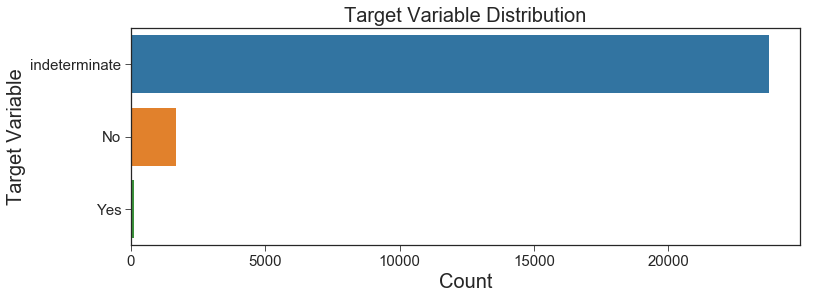

In [49]:
plot_data_dist_across_targ(salesReportDataTrain_dropped_attr_no_dup, "Suspicious")

### DataType Conversions

__Observations__

__1. Categorical datatype:__
SalesPersonID, ProductID, Suspicious

__2. Numeric datatype:__
Quantity, TotalSalesValue

In [50]:
salesReportDataTrain_dropped_attr_no_dup.dtypes

SalesPersonID      object
ProductID          object
Quantity            int64
TotalSalesValue     int64
Suspicious         object
dtype: object

In [51]:
cat_col = ['SalesPersonID', 'ProductID', 'Suspicious']
num_col = np.setdiff1d(salesReportDataTrain_dropped_attr_no_dup.columns, cat_col).tolist()

cat_col
num_col


['SalesPersonID', 'ProductID', 'Suspicious']

['Quantity', 'TotalSalesValue']

In [52]:
def covert_var(dataF, conversion_type):
    if(conversion_type=="cat"):
        converted_dataF = dataF.astype('category', copy=True)
    if(conversion_type=="num_float"):
        converted_dataF = dataF.astype('float64', copy=True)
    if(conversion_type=="num_int"):
        converted_dataF = dataF.astype('int64', copy=True)
    return converted_dataF


In [53]:
#Do the datatype conversion
salesReportDataTrain_dropped_attr_no_dup[cat_col] = covert_var(salesReportDataTrain_dropped_attr_no_dup[cat_col], "cat")
salesReportDataTrain_dropped_attr_no_dup[num_col] = covert_var(salesReportDataTrain_dropped_attr_no_dup[num_col], "num_float")    

salesReportDataTrain_dropped_attr_no_dup.head()
salesReportDataTrain_dropped_attr_no_dup.dtypes

,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious
4411,C22230,PR6246,104.0,1250.0,indeterminate
268,C21820,PR6165,410.0,3555.0,indeterminate
21330,C21179,PR6282,2756.0,8270.0,indeterminate
35509,C21453,PR6299,38182.0,223045.0,indeterminate
31373,C22267,PR6595,100.0,1148.0,No


SalesPersonID      category
ProductID          category
Quantity            float64
TotalSalesValue     float64
Suspicious         category
dtype: object

### Correlation Analysis
#### Between numeric attributes

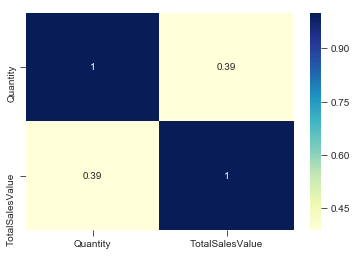

In [54]:
def get_correlation_plot(dataF):
    corr = dataF.corr()
    f, ax = plt.subplots(figsize=(6, 4))
    sns.heatmap(corr, ax=ax, annot=True, cmap="YlGnBu");

get_correlation_plot(salesReportDataTrain_dropped_attr_no_dup)

#### Correlation of different continuous attributes to target

In [55]:
def logistic_regg_Corr(dataF, target, solver='liblinear'):
    """
    This is to understand correlation between continuous IV & Categorical DV.
    """
    dataF_corr = dataF.dropna()
    X=dataF_corr.drop(target, axis=1)
    y=dataF_corr[target]
    for col_cor in X.columns :
        X_col_cor = X[col_cor].values.reshape(-1, 1)
        clf = LogisticRegression(random_state=0, solver=solver).fit(X_col_cor, y)
        print("Mean accuracy with column", col_cor, "is :", clf.score(X_col_cor, y))

In [56]:
salesReportDataTrain_dropped_attr_no_dup_target = pd.concat([salesReportDataTrain_dropped_attr_no_dup[num_col].reset_index(
    drop=True), salesReportDataTrain_dropped_attr_no_dup['Suspicious'].reset_index(drop=True)], axis=1)
logistic_regg_Corr(salesReportDataTrain_dropped_attr_no_dup_target, "Suspicious", solver='lbfgs')

Mean accuracy with column Quantity is : 0.929304402318659
Mean accuracy with column TotalSalesValue is : 0.9286385712047627


#### Correlation of different categorical attributes to target

In [57]:
def get_chi_square_corr_score(dataF, target, prob=0.95):
    """
    The Pearson’s chi-squared statistical hypothesis is an example of a test for independence between 
    categorical variables.
    """
    le = LabelEncoder()
    le.fit(dataF[target])
    dataF[target] = le.transform(dataF[target])
    
    alpha = 1.0 - prob
    print('Confidence level=%.3f and significance level=%.3f \n' % (prob, alpha))
    
    for column in dataF.columns.drop('Suspicious'):
        dataF[column].fillna(dataF[column].mode()[0], inplace=True)
        table = pd.crosstab(dataF[column], dataF[target])
        stat, p, dof, expected = chi2_contingency(table)
        
        """
        critical = chi2.ppf(prob, dof)
        print('probability=%.3f, critical=%.3f, stat=%.3f' % (prob, critical, stat))
        
        if abs(stat) >= critical:
            print('Dependent (reject H0), IV & DV are dependent')
        else:
            print('Independent (fail to reject H0), IV & DV are independent')
        """
        if p <= alpha:
            #print('Dependent (reject H0), IV & DV are dependent')
            print('IV : %s and DV: %s are dependent' % (column, target))
        else:
            #print('Independent (fail to reject H0), IV & DV are independent')
            print('IV : %s and DV: %s are independent' % (column, target))

In [58]:
get_chi_square_corr_score(salesReportDataTrain_dropped_attr_no_dup[cat_col], 'Suspicious', prob=0.99)

Confidence level=0.990 and significance level=0.010 

IV : SalesPersonID and DV: Suspicious are dependent
IV : ProductID and DV: Suspicious are dependent


__Observation__

1. There is no direct correlation between Quantity and TotalSalesValue as expected, there are multiple ProductID and SalesPersonID responsible for selling of products.
2. Accuracy of predicting target using __Quantity__ is high (~92%), but due to class imbalance of target (93% majority), its insignificant.
3. Accuracy of predicting target using __TotalSalesValue__ is high (~92%), but due to class imbalance of target (93% majority), its insignificant.
4. __SalesPersonID and target = Suspicious__ are highly dependent at 99% Confidence level.
5. __ProductID and target = Suspicious__ are highly dependent at 99% Confidence level.
6. There are scenarios when the same data ('SalesPersonID', 'ProductID', 'Quantity', 'TotalSalesValue') is assigned two different Suspicious value
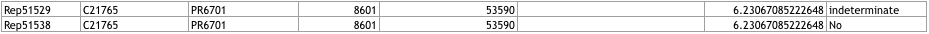

### How is the distribution of ProductID

If the Number of Products can be binned as others for less occurring ProductID?

In [59]:
def data_dist_across_val(dataF, target):
    """
    Plot target variable distribution
    """
    dataF_1 = dataF[target].value_counts().to_frame().rename(columns={'ProductID':'per_prod_count'})
    dataF_1['percent_prod_count'] = (dataF[target].value_counts()/dataF[target].count())*100
    dataF_1['cum_percent_prod_count'] = dataF_1['percent_prod_count'].cumsum()
    return dataF_1

data_dist_across_val_df = data_dist_across_val(salesReportDataTrain_dropped_attr_no_dup, "ProductID").reset_index()


In [60]:
trace = go.Line(x=data_dist_across_val_df.index ,
                  y= data_dist_across_val_df.cum_percent_prod_count,
                  name = 'Yes',
                  mode= 'markers')

layout = go.Layout(title = 'Cumulative Distribution of ProductID coverage',
                  xaxis = dict(title = 'Index',titlefont=dict(size=10), tickfont=dict(size=7)),
                  yaxis = dict(title = 'Cumulative Distribution',titlefont=dict(size=10)))

data = [trace]

fig = go.Figure(data=data, layout=layout)
iplot(fig)

### How is the distribution of SalesPersonID

If the Number of Products can be binned as others for less occurring SalesPersonID?

In [61]:
def data_dist_across_val(dataF, target):
    """
    Plot target variable distribution
    """
    dataF_1 = dataF[target].value_counts().to_frame().rename(columns={'SalesPersonID':'per_sales_p_count'})
    dataF_1['percent_sales_p_count'] = (dataF[target].value_counts()/dataF[target].count())*100
    dataF_1['cum_percent_sales_p_count'] = dataF_1['percent_sales_p_count'].cumsum()
    return dataF_1

data_dist_across_val_df = data_dist_across_val(salesReportDataTrain_dropped_attr_no_dup, "SalesPersonID").reset_index()


In [62]:
trace = go.Line(x=data_dist_across_val_df.index ,
                  y= data_dist_across_val_df.cum_percent_sales_p_count,
                  name = 'Yes',
                  mode= 'markers')

layout = go.Layout(title = 'Cumulative Distribution of SalesPersonID coverage',
                  xaxis = dict(title = 'Index',titlefont=dict(size=10), tickfont=dict(size=7)),
                  yaxis = dict(title = 'Cumulative Distribution',titlefont=dict(size=10)))

data = [trace]

fig = go.Figure(data=data, layout=layout)
iplot(fig)

__Observation__
1. 95% of the values in both ProductID & SalesPersonID Scenario are handled by huge number of district ProductID & SalesPersonID respectively. Hence this logic wont work.

## Implement Base algorithm

__Note__ : As this is a base algo we are using OHE directly on Categorical columns, expecting the number of columns will explode

In [63]:
salesReportDataTrain_dropped_attr_no_dup.dtypes

SalesPersonID      category
ProductID          category
Quantity            float64
TotalSalesValue     float64
Suspicious         category
dtype: object

### Segment the data into IV & DV

In [64]:
X_train = salesReportDataTrain_dropped_attr_no_dup.drop('Suspicious', axis=1)
y_train = salesReportDataTrain_dropped_attr_no_dup['Suspicious']

### Building Pipeline

In [65]:
num_col_split = list(X_train.select_dtypes(include='float').columns)
cat_col_split = list(X_train.select_dtypes(include='category').columns)

num_col_split
cat_col_split

['Quantity', 'TotalSalesValue']

['SalesPersonID', 'ProductID']

### Impute and scale attributes

In [66]:
def define_num_transformer(**transformers):
    steps=[]
    for key, value in transformers.items():
        if(key == "imputer"):
            steps.append((key, SimpleImputer(strategy=value)))
        elif(key == "scaler"):
            steps.append((key, StandardScaler()))
        else:
            return "Not a valid transformation"    
    return Pipeline(memory ='./' ,steps=steps)


def define_cat_transformer(**transformers):
    steps=[]
    for key, value in transformers.items():
        if(key == "imputer"):
            steps.append(('imputer', SimpleImputer(strategy='most_frequent', fill_value='missing')))
        elif(key == "dummyfication_onehot"):
            steps.append(('onehot', OneHotEncoder(handle_unknown='ignore')))
        else:
            return "Not a valid transformation"
    return Pipeline(memory ='./' ,steps=steps)


def get_column_transformer(num_transformer=None, num_col_split=None, cat_transformer=None, cat_col_split=None):
    transformer_step=[]
    if(num_transformer != None):
        transformer_step.append(('num', num_transformer, num_col_split))
    if(cat_transformer != None):
        transformer_step.append(('cat', cat_transformer, cat_col_split))
    return ColumnTransformer(transformers=transformer_step)        


In [67]:
num_transformer_step = {"scaler":"StandardScaler"}
num_transformer = define_num_transformer(**num_transformer_step)

cat_transformer_step = {"dummyfication_onehot":"OneHotEncoder"}
cat_transformer = define_cat_transformer(**cat_transformer_step)

preprocessor = get_column_transformer(num_transformer, num_col_split, cat_transformer, cat_col_split)
preprocessor

ColumnTransformer(n_jobs=None, remainder='drop', sparse_threshold=0.3,
         transformer_weights=None,
         transformers=[('num', Pipeline(memory='./',
     steps=[('scaler', StandardScaler(copy=True, with_mean=True, with_std=True))]), ['Quantity', 'TotalSalesValue']), ('cat', Pipeline(memory='./',
     steps=[('onehot', OneHotEncoder(categorical_features=None, categories=None,
       dtype=<class 'numpy.float64'>, handle_unknown='ignore',
       n_values=None, sparse=True))]), ['SalesPersonID', 'ProductID'])])

### Build pipeline

In [68]:
def add_to_pipeline(**final_pipeline_steps):
    steps=[]
    for key, value in final_pipeline_steps.items():
        if(key == "preprocessor"):
            steps.append(('preprocessor', value))
        elif(key == "baseModel"):
            steps.append(('classifier', value))
        else:
            return "Not a valid step"
    return impipe(steps=steps)


In [69]:
#Pipeline steps to be added to imBalance pipeline
baseModel = LogisticRegression()
steps = {"preprocessor" : preprocessor, "baseModel": baseModel}
im_pipe_clf = add_to_pipeline(**steps)

### Grid Search

In [70]:
def simple_calssification_grid_space():
    return [{'classifier': [LogisticRegression()],
             'classifier__C': [3,7],
             'classifier__penalty': ["l1","l2"],
             'classifier__class_weight': [None, "balanced"]},
            {'classifier': [DecisionTreeClassifier(random_state=0)],
             'classifier__max_depth': [2,3,5,9],
             'classifier__class_weight': [None, "balanced"]}]

### Custom Scoring

In [71]:
def custom_recall_score(ground_truth, predictions):
    return recall_score(ground_truth, predictions, labels=['Yes'], average=None)

cust_recall_score = make_scorer(custom_recall_score, greater_is_better=True)

In [72]:
#Search Space for base classifier
search_space = simple_calssification_grid_space()

#Define repeated KFold
rkf = RepeatedKFold(n_splits=10, n_repeats=3, random_state=0)


CV_grid_model = GridSearchCV(
    estimator=im_pipe_clf, param_grid=search_space, cv= rkf, scoring=cust_recall_score, n_jobs=-1, verbose=3, refit=True)
CV_grid_model.fit(X=X_train, y=y_train)


Fitting 30 folds for each of 16 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    6.1s
[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:   27.7s
[Parallel(n_jobs=-1)]: Done 272 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:  1.6min finished


GridSearchCV(cv=<sklearn.model_selection._split.RepeatedKFold object at 0x1c24c4e0f0>,
       error_score='raise-deprecating',
       estimator=Pipeline(memory=None,
     steps=[('preprocessor', ColumnTransformer(n_jobs=None, remainder='drop', sparse_threshold=0.3,
         transformer_weights=None,
         transformers=[('num', Pipeline(memory='./',
     steps=[('scaler', StandardScaler(copy=True, with_mean=True, with_std=True))]), ['Quantity', 'TotalSalesValue']),...penalty='l2', random_state=None, solver='warn',
          tol=0.0001, verbose=0, warm_start=False))]),
       fit_params=None, iid='warn', n_jobs=-1,
       param_grid=[{'classifier': [LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='warn',
          tol=0.0001, verbose=0, warm_start=False)], 'class...er='best')], 'classifier__max_depth': [2, 3, 5, 9], 'classifier__c

In [73]:
def get_grid_summary(gs_model):
    print('Best score = ', gs_model.best_score_)
    print('\n')
    
    print('Best parameter : ')
    print(gs_model.best_params_)    
    print('\n')
    
    print('Best Model : ')
    print(gs_model.best_estimator_.get_params()['classifier'])
    print('\n')
    
    print('Grid search execution stat :')
    return pd.DataFrame(gs_model.cv_results_)

In [74]:
get_grid_summary(CV_grid_model)

Best score =  0.7670990599520887


Best parameter : 
{'classifier': DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=0,
            splitter='best'), 'classifier__class_weight': 'balanced', 'classifier__max_depth': 5}


Best Model : 
DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=0,
            splitter='best')


Grid search execution stat :


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier,param_classifier__C,param_classifier__class_weight,param_classifier__penalty,param_classifier__max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,split10_test_score,split11_test_score,split12_test_score,split13_test_score,split14_test_score,split15_test_score,split16_test_score,split17_test_score,split18_test_score,split19_test_score,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,split10_train_score,split11_train_score,split12_train_score,split13_train_score,split14_train_score,split15_train_score,split16_train_score,split17_train_score,split18_train_score,split19_train_score,split20_train_score,split21_train_score,split22_train_score,split23_train_score,split24_train_score,split25_train_score,split26_train_score,split27_train_score,split28_train_score,split29_train_score,mean_train_score,std_train_score
0,1.024533,0.062352,0.024308,0.001619,"LogisticRegression(C=1.0, class_weight=None, d...",3,None,l1,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.00,0.000000,0.000000,0.000000,0.0,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.0,0.000000,0.00,0.000000,...,0.031496,0.042373,0.045802,0.034483,0.032520,0.033058,0.032520,0.031496,0.032520,0.032787,0.024793,0.041667,0.031496,0.049180,0.039683,0.032258,0.034483,0.032520,0.025210,0.032787,0.033058,0.032787,0.060345,0.016529,0.045802,0.040650,0.032,0.032258,0.035688,0.008096
1,0.497900,0.072028,0.027367,0.003169,"LogisticRegression(C=1.0, class_weight=None, d...",3,None,l2,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.00,0.000000,0.000000,0.000000,0.0,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.0,0.000000,0.00,0.000000,...,0.000000,0.000000,0.000000,0.008621,0.000000,0.008264,0.008130,0.000000,0.000000,0.000000,0.008264,0.008333,0.000000,0.008197,0.000000,0.008065,0.008621,0.000000,0.000000,0.000000,0.000000,0.008197,0.000000,0.000000,0.007634,0.008130,0.000,0.000000,0.003015,0.003966
2,3.458213,0.304014,0.030131,0.003862,"LogisticRegression(C=1.0, class_weight=None, d...",3,balanced,l1,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.20,0.285714,0.444444,0.222222,0.0,0.15,0.153846,0.133333,0.076923,0.000000,0.153846,0.071429,0.000000,0.1875,0.111111,0.142857,0.2,0.333333,0.10,0.230769,...,0.874016,0.872881,0.877863,0.896552,0.886179,0.884298,0.845528,0.858268,0.886179,0.893443,0.876033,0.891667,0.858268,0.893443,0.865079,0.903226,0.887931,0.878049,0.865546,0.868852,0.909091,0.877049,0.862069,0.884298,0.839695,0.910569,0.888,0.879032,0.880965,0.018293
3,0.760666,0.092900,0.032151,0.007348,"LogisticRegression(C=1.0, class_weight=None, d...",3,balanced,l2,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.20,0.285714,0.444444,0.111111,0.0,0.15,0.153846,0.133333,0.076923,0.111111,0.230769,0.071429,0.000000,0.1875,0.111111,0.142857,0.3,0.250000,0.10,0.307692,...,0.858268,0.881356,0.862595,0.879310,0.910569,0.884298,0.861789,0.881890,0.869919,0.852459,0.876033,0.883333,0.850394,0.885246,0.873016,0.862903,0.887931,0.869919,0.873950,0.868852,0.876033,0.868852,0.862069,0.859504,0.854962,0.886179,0.872,0.887097,0.873264,0.013505
4,2.259197,0.080784,0.031511,0.003884,"LogisticRegression(C=1.0, class_weight=None, d...",7,None,l1,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.00,0.000000,0.000000,0.000000,0.0,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.0,0.000000,0.00,0.000000,...,0.055118,0.067797,0.068702,0.077586,0.056911,0.082645,0.073171,0.062992,0.065041,0.081967,0.057851,0.075000,0.070866,0.098361,0.071429,0.064516,0.068966,0.048780,0.058824,0.073770,0.074380,0.065574

### Plot Learning curve

In [75]:
def plot_learning_curve(estimator, title, X, y, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    plt.figure(figsize = (8,8))
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes, scoring=cust_recall_score)
    
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    
    plt.grid()
    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="b",
             label="Cross-validation score")

    plt.legend(loc="best")
    plt.show()


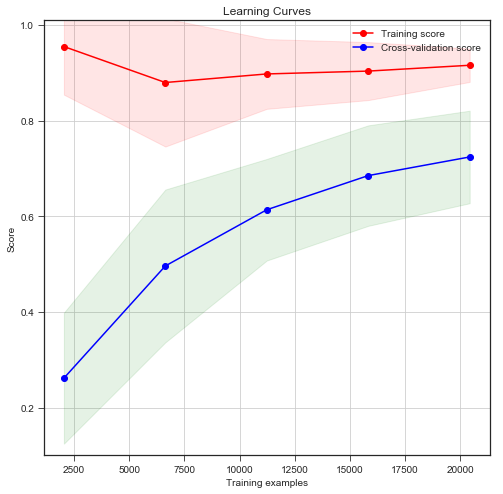

In [76]:
# Cross validation with 10 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)


steps = {"preprocessor" : preprocessor}
im_pipe_pre_process = add_to_pipeline(**steps)
estimator = CV_grid_model.best_estimator_.get_params()['classifier']
title = r"Learning Curves"
plot_learning_curve(estimator, title, im_pipe_pre_process.fit_transform(X_train), y_train, 
                       (0.1, 1.01), cv=cv, n_jobs=-1)

### Training data evaluation

In [77]:
def evaluate_model(model, X, y):
    y_pred = model.predict(X)
    print("Accuracy score :", accuracy_score(y,y_pred))
    print("classification_report :\n",classification_report(y,y_pred,digits=4))
    return y_pred

In [78]:
y_pred = evaluate_model(CV_grid_model, X_train, y_train)
y_pred

Accuracy score : 0.6207112642957857
classification_report :
                precision    recall  f1-score   support

           No     0.1293    0.7655    0.2212      1663
          Yes     0.1377    0.8750    0.2380       136
indeterminate     0.9752    0.6091    0.7499     23733

    micro avg     0.6207    0.6207    0.6207     25532
    macro avg     0.4141    0.7499    0.4030     25532
 weighted avg     0.9157    0.6207    0.7127     25532



array(['No', 'indeterminate', 'indeterminate', ..., 'indeterminate',
       'indeterminate', 'indeterminate'], dtype=object)

__Observations__

1. DecisionTreeClassifier performs the best amongst the tried classifiers.
2. A learning curve shows how error changes as the training set size increases. Learning curves give us an opportunity to diagnose bias and variance in supervised learning models.
3. The training scores is high & validation score is comparatively much lower. __High Variance Problem__. As we are classifying a given report by a salesman as Suspicious, we need to be absolutely sure before defaming, hence VERY high Recall required.
7. As its a high variance problem, training the current learning algorithm needs to generalize.
8. We should also try out bagging algo like Random forest etc.
9. Also to note is, the training error is also in the range of 87-90%, which can be tackled by improving features.

### Evaluate the model on test data

In [79]:
#Drop ReportID column, as in case of train
salesReportDataTest_dropped_attr_no_dup = salesReportDataTest.drop(['ReportID'], axis=1)

# Datatype conversions
salesReportDataTest_dropped_attr_no_dup[cat_col] = covert_var(salesReportDataTest_dropped_attr_no_dup[cat_col], "cat")
salesReportDataTest_dropped_attr_no_dup[num_col] = covert_var(salesReportDataTest_dropped_attr_no_dup[num_col], "num_float")    

X_test = salesReportDataTest_dropped_attr_no_dup.drop('Suspicious', axis=1)
y_test = salesReportDataTest_dropped_attr_no_dup['Suspicious']


y_test_pred = evaluate_model(CV_grid_model, X_test, y_test)
y_test_pred

Accuracy score : 0.6114033439789592
classification_report :
                precision    recall  f1-score   support

           No     0.1148    0.7371    0.1986       639
          Yes     0.0659    0.5333    0.1174        45
indeterminate     0.9735    0.6037    0.7452      9962

    micro avg     0.6114    0.6114    0.6114     10646
    macro avg     0.3847    0.6247    0.3537     10646
 weighted avg     0.9181    0.6114    0.7098     10646



array(['indeterminate', 'indeterminate', 'indeterminate', ..., 'No', 'No',
       'indeterminate'], dtype=object)

### Confusion matrix

In [80]:
def plot_confusion_matrix(y, y_pred):
    lables = list(set(y))
    ax= plt.subplot()
    cm = confusion_matrix(y, y_pred,lables)
    sns.heatmap(cm, annot=True, ax = ax, cmap="YlGnBu");
    print(cm)
    
    ax.set_xlabel('Predicted labels');
    ax.set_ylabel('True labels');
    ax.set_title('Confusion Matrix');
    ax.xaxis.set_ticklabels(lables);
    ax.yaxis.set_ticklabels(lables);


[[ 471   10  158]
 [  15   24    6]
 [3618  330 6014]]


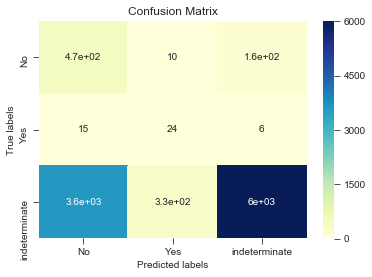

In [81]:
plot_confusion_matrix(y_test,y_test_pred)

__Observation__
1. Recall of 75 % (Suspicious=YES) is observed on test data.

## Approach 2 
__Drop rows that have more than one Independent variable for the same Dependent variable__

In [82]:
salesReportDataTrain_identify_suspicious_redundancy_1 = salesReportDataTrain.drop(
    'ReportID', axis=1).drop_duplicates(keep='first')
print(salesReportDataTrain.shape)
print(salesReportDataTrain_identify_suspicious_redundancy_1.shape)

(31936, 6)
(25532, 5)


In [83]:
# Remove rows with more than one Independent variable for the same Dependent variable
salesReportDataTrain_identify_suspicious_redundancy = salesReportDataTrain_identify_suspicious_redundancy_1.drop_duplicates(
    subset=['SalesPersonID', 'ProductID','Quantity', 'TotalSalesValue'], keep="last")
salesReportDataTrain_identify_suspicious_redundancy.shape

(25436, 5)

In [84]:
cat_col = ['SalesPersonID', 'ProductID', 'Suspicious']
num_col = np.setdiff1d(salesReportDataTrain_identify_suspicious_redundancy.columns, cat_col).tolist()

cat_col
num_col


['SalesPersonID', 'ProductID', 'Suspicious']

['Quantity', 'TotalSalesValue']

In [85]:
salesReportDataTrain_identify_suspicious_redundancy[cat_col] = covert_var(salesReportDataTrain_identify_suspicious_redundancy[cat_col], "cat")
salesReportDataTrain_identify_suspicious_redundancy[num_col] = covert_var(salesReportDataTrain_identify_suspicious_redundancy[num_col], "num_float")    

salesReportDataTrain_identify_suspicious_redundancy.head()
salesReportDataTrain_identify_suspicious_redundancy.dtypes


,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious
4411,C22230,PR6246,104.0,1250.0,indeterminate
268,C21820,PR6165,410.0,3555.0,indeterminate
21330,C21179,PR6282,2756.0,8270.0,indeterminate
35509,C21453,PR6299,38182.0,223045.0,indeterminate
4568,C21885,PR6131,320.0,1805.0,indeterminate


SalesPersonID      category
ProductID          category
Quantity            float64
TotalSalesValue     float64
Suspicious         category
dtype: object

In [86]:
X_train = salesReportDataTrain_identify_suspicious_redundancy.drop('Suspicious', axis=1)
y_train = salesReportDataTrain_identify_suspicious_redundancy['Suspicious']

In [87]:
#Search Space for base classifier
search_space = simple_calssification_grid_space()

#Define repeated KFold
rkf = RepeatedKFold(n_splits=10, n_repeats=3, random_state=0)

CV_grid_model = GridSearchCV(
    estimator=im_pipe_clf, param_grid=search_space, cv= rkf, scoring=cust_recall_score, n_jobs=-1, verbose=3, refit=True)
CV_grid_model.fit(X=X_train, y=y_train)

Fitting 30 folds for each of 16 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:   23.3s
[Parallel(n_jobs=-1)]: Done 272 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:  1.4min finished


GridSearchCV(cv=<sklearn.model_selection._split.RepeatedKFold object at 0x1c248d4ba8>,
       error_score='raise-deprecating',
       estimator=Pipeline(memory=None,
     steps=[('preprocessor', ColumnTransformer(n_jobs=None, remainder='drop', sparse_threshold=0.3,
         transformer_weights=None,
         transformers=[('num', Pipeline(memory='./',
     steps=[('scaler', StandardScaler(copy=True, with_mean=True, with_std=True))]), ['Quantity', 'TotalSalesValue']),...penalty='l2', random_state=None, solver='warn',
          tol=0.0001, verbose=0, warm_start=False))]),
       fit_params=None, iid='warn', n_jobs=-1,
       param_grid=[{'classifier': [LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='warn',
          tol=0.0001, verbose=0, warm_start=False)], 'class...er='best')], 'classifier__max_depth': [2, 3, 5, 9], 'classifier__c

In [88]:
get_grid_summary(CV_grid_model)

Best score =  0.7736874652217931


Best parameter : 
{'classifier': DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=0,
            splitter='best'), 'classifier__class_weight': 'balanced', 'classifier__max_depth': 5}


Best Model : 
DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=5,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=0,
            splitter='best')


Grid search execution stat :


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier,param_classifier__C,param_classifier__class_weight,param_classifier__penalty,param_classifier__max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,split10_test_score,split11_test_score,split12_test_score,split13_test_score,split14_test_score,split15_test_score,split16_test_score,split17_test_score,split18_test_score,split19_test_score,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,split10_train_score,split11_train_score,split12_train_score,split13_train_score,split14_train_score,split15_train_score,split16_train_score,split17_train_score,split18_train_score,split19_train_score,split20_train_score,split21_train_score,split22_train_score,split23_train_score,split24_train_score,split25_train_score,split26_train_score,split27_train_score,split28_train_score,split29_train_score,mean_train_score,std_train_score
0,1.017898,0.041832,0.023511,0.002216,"LogisticRegression(C=1.0, class_weight=None, d...",3,None,l1,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.0000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0000,0.000000,0.000,0.0000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,...,0.048,0.040984,0.032787,0.024390,0.042373,0.047619,0.025000,0.040984,0.039062,0.033333,0.031746,0.040650,0.033058,0.048,0.034188,0.060870,0.023438,0.024793,0.040323,0.048,0.030769,0.026549,0.033898,0.033613,0.055118,0.034483,0.032,0.031496,0.037838,0.009439
1,0.436235,0.069171,0.024487,0.001783,"LogisticRegression(C=1.0, class_weight=None, d...",3,None,l2,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.0000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0000,0.000000,0.000,0.0000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,...,0.000,0.000000,0.000000,0.000000,0.000000,0.007937,0.000000,0.000000,0.000000,0.000000,0.007937,0.000000,0.000000,0.008,0.000000,0.000000,0.000000,0.008264,0.016129,0.008,0.007692,0.008850,0.000000,0.000000,0.007874,0.008621,0.000,0.000000,0.003519,0.004536
2,3.399700,0.237010,0.027980,0.003236,"LogisticRegression(C=1.0, class_weight=None, d...",3,balanced,l1,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.1875,0.2,0.000000,0.214286,0.071429,0.230769,0.166667,0.1,0.1875,0.000000,0.250,0.1875,0.1,0.000000,0.066667,0.363636,0.210526,0.095238,0.125,0.200000,...,0.880,0.852459,0.877049,0.894309,0.906780,0.880952,0.858333,0.885246,0.882812,0.858333,0.896825,0.902439,0.892562,0.880,0.871795,0.886957,0.851562,0.859504,0.911290,0.872,0.869231,0.884956,0.855932,0.873950,0.874016,0.862069,0.864,0.866142,0.877219,0.016278
3,0.726418,0.062601,0.028249,0.002302,"LogisticRegression(C=1.0, class_weight=None, d...",3,balanced,l2,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.3125,0.2,0.000000,0.214286,0.071429,0.153846,0.166667,0.1,0.1875,0.000000,0.250,0.1875,0.1,0.000000,0.133333,0.363636,0.210526,0.047619,0.125,0.200000,...,0.864,0.844262,0.868852,0.878049,0.898305,0.857143,0.883333,0.860656,0.867188,0.858333,0.888889,0.886179,0.876033,0.872,0.863248,0.878261,0.851562,0.851240,0.862903,0.872,0.869231,0.876106,0.881356,0.882353,0.842520,0.879310,0.864,0.850394,0.869482,0.013816
4,2.226368,0.135396,0.029037,0.002188,"LogisticRegression(C=1.0, class_weight=None, d...",7,None,l1,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.0000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0000,0.000000,0.000,0.0000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,...,0.072,0.073770,0.073770,0.056911,0.076271,0.071429,0.058333,0.081967,0.078125,0.066667,0.071429,0.097561,0.074380,0.080,0.051282,0.069565,0.046875,0.066116,0.088710,0.056,0.069231,0.061947,0.059322,0.067227,0.070866,0.068966,0.064,0.070866,0.069125

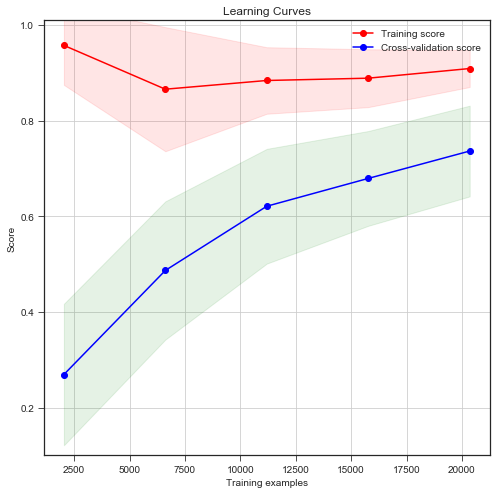

In [89]:
# Cross validation with 10 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)


steps = {"preprocessor" : preprocessor}
im_pipe_pre_process = add_to_pipeline(**steps)
estimator = CV_grid_model.best_estimator_.get_params()['classifier']
title = r"Learning Curves"
plot_learning_curve(estimator, title, im_pipe_pre_process.fit_transform(X_train), y_train, 
                       (0.1, 1.01), cv=cv, n_jobs=-1)

In [90]:
y_pred = evaluate_model(CV_grid_model, X_train, y_train)
y_pred

Accuracy score : 0.6282041201446769
classification_report :
                precision    recall  f1-score   support

           No     0.1291    0.7618    0.2208      1625
          Yes     0.1385    0.8750    0.2392       136
indeterminate     0.9756    0.6176    0.7564     23675

    micro avg     0.6282    0.6282    0.6282     25436
    macro avg     0.4144    0.7515    0.4055     25436
 weighted avg     0.9171    0.6282    0.7194     25436



array(['No', 'indeterminate', 'indeterminate', ..., 'indeterminate',
       'indeterminate', 'indeterminate'], dtype=object)

In [91]:
#Drop ReportID column, as in case of train
salesReportDataTest_dropped_attr_no_dup = salesReportDataTest.drop(['ReportID'], axis=1)

# Datatype conversions
salesReportDataTest_dropped_attr_no_dup[cat_col] = covert_var(salesReportDataTest_dropped_attr_no_dup[cat_col], "cat")
salesReportDataTest_dropped_attr_no_dup[num_col] = covert_var(salesReportDataTest_dropped_attr_no_dup[num_col], "num_float")    

X_test = salesReportDataTest_dropped_attr_no_dup.drop('Suspicious', axis=1)
y_test = salesReportDataTest_dropped_attr_no_dup['Suspicious']


y_test_pred = evaluate_model(CV_grid_model, X_test, y_test)
y_test_pred

Accuracy score : 0.6184482434717264
classification_report :
                precision    recall  f1-score   support

           No     0.1162    0.7308    0.2005       639
          Yes     0.0658    0.5333    0.1171        45
indeterminate     0.9732    0.6116    0.7512      9962

    micro avg     0.6184    0.6184    0.6184     10646
    macro avg     0.3850    0.6253    0.3562     10646
 weighted avg     0.9179    0.6184    0.7154     10646



array(['indeterminate', 'indeterminate', 'indeterminate', ..., 'No', 'No',
       'indeterminate'], dtype=object)

[[ 467   10  162]
 [  15   24    6]
 [3538  331 6093]]


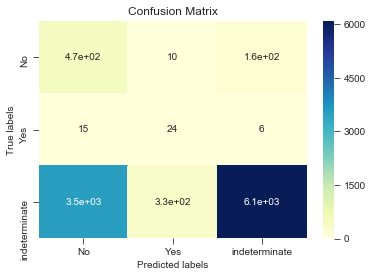

In [92]:
plot_confusion_matrix(y_test,y_test_pred)

__Observation__
1. No change in Recall, by dropping rows with multiple labels.

## Approach 3

Using the derived columns to model

In [93]:
# Drop duplicate rows
salesReportDataTrain_add_feature_grp_P_and_S_no_dup = salesReportDataTrain_add_feature_grp_P_and_S.drop('ReportID', axis=1).drop_duplicates()
salesReportDataTrain_add_feature_grp_P_and_S_no_dup.shape
salesReportDataTrain_add_feature_grp_P_and_S_no_dup.head()
salesReportDataTrain_add_feature_grp_P_and_S_no_dup.dtypes

(25532, 21)

,SalesPersonID,ProductID,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,SalesValuePerItemVariationFromAvgSalesMan,perc_Quantity_by_SalesMan,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID,SalesValuePerItemVariationFromAvgSalesManProductID,perc_Quantity_by_SalesMan_ProductID
0,C22230,PR6246,104,1250,12.019231,indeterminate,172910,26911,6.425254,87.062356,0.386459,546690,106552,5.130734,134.259466,0.097605,16290,549,29.672131,59.493200,18.943534
1,C22230,PR6246,119,5515,46.344538,indeterminate,172910,26911,6.425254,621.287292,0.442198,546690,106552,5.130734,803.273005,0.111683,16290,549,29.672131,56.188774,21.675774
2,C22230,PR6246,133,4975,37.406015,indeterminate,172910,26911,6.425254,482.171807,0.494222,546690,106552,5.130734,629.057732,0.124822,16290,549,29.672131,26.064471,24.225865
3,C22230,PR6246,193,4550,23.575130,indeterminate,172910,26911,6.425254,266.913603,0.717179,546690,106552,5.130734,359.488412,0.181132,16290,549,29.672131,20.547906,35.154827
4,C22230,PR6115,685,5270,7.693431,indeterminate,9453585,1883862,5.018194,53.310746,0.036361,546690,106552,5.130734,49.947946,0.642879,57135,9987,5.720937,34.478502,6.858917


SalesPersonID                                          object
ProductID                                              object
Quantity                                                int64
TotalSalesValue                                         int64
SalesValuePerItem                                     float64
Suspicious                                             object
TotalSalesValueByProduct                                int64
QuantityByProduct                                       int64
AverageSalesValueByProduct                            float64
SalesValuePerItemVariationFromAvgProduct              float64
perc_Quantity_by_Product                              float64
TotalSalesValueBySalesMan                               int64
QuantityBySalesMan                                      int64
AverageSalesValueBySalesMan                           float64
SalesValuePerItemVariationFromAvgSalesMan             float64
perc_Quantity_by_SalesMan                             float64
TotalSal

In [94]:
# Drop not required columns
col_to_drop = ['SalesPersonID', 'ProductID', 
               'TotalSalesValueByProduct', 'QuantityByProduct', 'AverageSalesValueByProduct',
               'TotalSalesValueBySalesMan', 'QuantityBySalesMan', 'AverageSalesValueBySalesMan',
              'TotalSalesValueBySalesManProductID', 'QuantityBySalesManProductID', 'AverageSalesValueBySalesManProductID',
              'SalesValuePerItemVariationFromAvgSalesManProductID', 'perc_Quantity_by_SalesMan_ProductID']
salesReportDataTrain_no_dup_col_fillter = salesReportDataTrain_add_feature_grp_P_and_S_no_dup.drop(
    col_to_drop, axis=1)
salesReportDataTrain_no_dup_col_fillter.dtypes
salesReportDataTrain_no_dup_col_fillter.head()

Quantity                                       int64
TotalSalesValue                                int64
SalesValuePerItem                            float64
Suspicious                                    object
SalesValuePerItemVariationFromAvgProduct     float64
perc_Quantity_by_Product                     float64
SalesValuePerItemVariationFromAvgSalesMan    float64
perc_Quantity_by_SalesMan                    float64
dtype: object

,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,SalesValuePerItemVariationFromAvgSalesMan,perc_Quantity_by_SalesMan
0,104,1250,12.019231,indeterminate,87.062356,0.386459,134.259466,0.097605
1,119,5515,46.344538,indeterminate,621.287292,0.442198,803.273005,0.111683
2,133,4975,37.406015,indeterminate,482.171807,0.494222,629.057732,0.124822
3,193,4550,23.575130,indeterminate,266.913603,0.717179,359.488412,0.181132
4,685,5270,7.693431,indeterminate,53.310746,0.036361,49.947946,0.642879


In [95]:
cat_col = ['Suspicious']
num_col = np.setdiff1d(salesReportDataTrain_no_dup_col_fillter.columns, cat_col).tolist()

cat_col
num_col


['Suspicious']

['Quantity',
 'SalesValuePerItem',
 'SalesValuePerItemVariationFromAvgProduct',
 'SalesValuePerItemVariationFromAvgSalesMan',
 'TotalSalesValue',
 'perc_Quantity_by_Product',
 'perc_Quantity_by_SalesMan']

In [96]:
salesReportDataTrain_no_dup_col_fillter[cat_col] = covert_var(salesReportDataTrain_no_dup_col_fillter[cat_col], "cat")
salesReportDataTrain_no_dup_col_fillter[num_col] = covert_var(salesReportDataTrain_no_dup_col_fillter[num_col], "num_float")    

salesReportDataTrain_no_dup_col_fillter.head()
salesReportDataTrain_no_dup_col_fillter.dtypes


,Quantity,TotalSalesValue,SalesValuePerItem,Suspicious,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,SalesValuePerItemVariationFromAvgSalesMan,perc_Quantity_by_SalesMan
0,104.0,1250.0,12.019231,indeterminate,87.062356,0.386459,134.259466,0.097605
1,119.0,5515.0,46.344538,indeterminate,621.287292,0.442198,803.273005,0.111683
2,133.0,4975.0,37.406015,indeterminate,482.171807,0.494222,629.057732,0.124822
3,193.0,4550.0,23.575130,indeterminate,266.913603,0.717179,359.488412,0.181132
4,685.0,5270.0,7.693431,indeterminate,53.310746,0.036361,49.947946,0.642879


Quantity                                      float64
TotalSalesValue                               float64
SalesValuePerItem                             float64
Suspicious                                   category
SalesValuePerItemVariationFromAvgProduct      float64
perc_Quantity_by_Product                      float64
SalesValuePerItemVariationFromAvgSalesMan     float64
perc_Quantity_by_SalesMan                     float64
dtype: object

In [97]:
X_train = salesReportDataTrain_no_dup_col_fillter.drop('Suspicious', axis=1)
y_train = salesReportDataTrain_no_dup_col_fillter['Suspicious']

In [98]:
num_col_split = list(X_train.select_dtypes(include='float').columns)
cat_col_split = list(X_train.select_dtypes(include='category').columns)

num_col_split
cat_col_split

['Quantity',
 'TotalSalesValue',
 'SalesValuePerItem',
 'SalesValuePerItemVariationFromAvgProduct',
 'perc_Quantity_by_Product',
 'SalesValuePerItemVariationFromAvgSalesMan',
 'perc_Quantity_by_SalesMan']

[]

In [99]:
num_transformer_step = {"scaler":"StandardScaler"}
num_transformer = define_num_transformer(**num_transformer_step)

cat_transformer_step = {"dummyfication_onehot":"OneHotEncoder"}
cat_transformer = define_cat_transformer(**cat_transformer_step)

preprocessor = get_column_transformer(num_transformer, num_col_split, cat_transformer, cat_col_split)
preprocessor

ColumnTransformer(n_jobs=None, remainder='drop', sparse_threshold=0.3,
         transformer_weights=None,
         transformers=[('num', Pipeline(memory='./',
     steps=[('scaler', StandardScaler(copy=True, with_mean=True, with_std=True))]), ['Quantity', 'TotalSalesValue', 'SalesValuePerItem', 'SalesValuePerItemVariationFromAvgProduct', 'perc_Quantity_by_Product', 'SalesValuePerItemVariationFromAvgSalesMan', 'p... dtype=<class 'numpy.float64'>, handle_unknown='ignore',
       n_values=None, sparse=True))]), [])])

In [100]:
#Pipeline steps to be added to imBalance pipeline
baseModel = LogisticRegression()
steps = {"preprocessor" : preprocessor, "baseModel": baseModel}
im_pipe_clf = add_to_pipeline(**steps)

In [101]:
#Search Space for base classifier
search_space = simple_calssification_grid_space()

#Define repeated KFold
rkf = RepeatedKFold(n_splits=10, n_repeats=3, random_state=0)


CV_grid_model = GridSearchCV(
    estimator=im_pipe_clf, param_grid=search_space, cv= rkf, scoring=cust_recall_score, n_jobs=-1, verbose=3, refit=True)
CV_grid_model.fit(X=X_train, y=y_train)

Fitting 30 folds for each of 16 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 112 tasks      | elapsed:   11.5s
[Parallel(n_jobs=-1)]: Done 272 tasks      | elapsed:   28.3s
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed:   44.7s finished


GridSearchCV(cv=<sklearn.model_selection._split.RepeatedKFold object at 0x1c23b023c8>,
       error_score='raise-deprecating',
       estimator=Pipeline(memory=None,
     steps=[('preprocessor', ColumnTransformer(n_jobs=None, remainder='drop', sparse_threshold=0.3,
         transformer_weights=None,
         transformers=[('num', Pipeline(memory='./',
     steps=[('scaler', StandardScaler(copy=True, with_mean=True, with_std=True))]), ['Quantity', 'TotalSalesValue', '...penalty='l2', random_state=None, solver='warn',
          tol=0.0001, verbose=0, warm_start=False))]),
       fit_params=None, iid='warn', n_jobs=-1,
       param_grid=[{'classifier': [LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='warn',
          tol=0.0001, verbose=0, warm_start=False)], 'class...er='best')], 'classifier__max_depth': [2, 3, 5, 9], 'classifier__c

In [102]:
get_grid_summary(CV_grid_model)

Best score =  0.8578067482320275


Best parameter : 
{'classifier': DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=3,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=0,
            splitter='best'), 'classifier__class_weight': 'balanced', 'classifier__max_depth': 3}


Best Model : 
DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=3,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=0,
            splitter='best')


Grid search execution stat :


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_classifier,param_classifier__C,param_classifier__class_weight,param_classifier__penalty,param_classifier__max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,split10_test_score,split11_test_score,split12_test_score,split13_test_score,split14_test_score,split15_test_score,split16_test_score,split17_test_score,split18_test_score,split19_test_score,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,split10_train_score,split11_train_score,split12_train_score,split13_train_score,split14_train_score,split15_train_score,split16_train_score,split17_train_score,split18_train_score,split19_train_score,split20_train_score,split21_train_score,split22_train_score,split23_train_score,split24_train_score,split25_train_score,split26_train_score,split27_train_score,split28_train_score,split29_train_score,mean_train_score,std_train_score
0,0.280628,0.039462,0.021906,0.003367,"LogisticRegression(C=1.0, class_weight=None, d...",3,None,l1,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.076923,0.000,0.307692,0.111111,0.200000,0.2500,0.210526,0.363636,0.142857,0.277778,0.133333,0.333333,0.428571,0.250000,0.235294,0.210526,0.076923,0.000000,0.000000,0.166667,...,0.195122,0.212598,0.206612,0.200000,0.205128,0.192,0.221311,0.194915,0.223140,0.186441,0.188525,0.201613,0.210084,0.213675,0.219512,0.220472,0.224806,0.209677,0.196581,0.201613,0.225806,0.220339,0.213115,0.207692,0.216,0.213115,0.188525,0.191667,0.208205,0.012204
1,0.351668,0.058462,0.025001,0.004457,"LogisticRegression(C=1.0, class_weight=None, d...",3,None,l2,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.076923,0.000,0.307692,0.111111,0.200000,0.2500,0.210526,0.363636,0.142857,0.277778,0.133333,0.333333,0.428571,0.250000,0.235294,0.210526,0.076923,0.000000,0.000000,0.166667,...,0.195122,0.212598,0.206612,0.200000,0.205128,0.192,0.221311,0.194915,0.223140,0.186441,0.188525,0.201613,0.210084,0.213675,0.219512,0.220472,0.224806,0.209677,0.196581,0.201613,0.225806,0.220339,0.213115,0.207692,0.216,0.213115,0.188525,0.191667,0.208205,0.012204
2,0.572866,0.080051,0.035567,0.005132,"LogisticRegression(C=1.0, class_weight=None, d...",3,balanced,l1,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.307692,0.250,0.307692,0.444444,0.600000,0.3750,0.421053,0.454545,0.214286,0.500000,0.533333,0.444444,0.500000,0.333333,0.294118,0.368421,0.384615,0.333333,0.142857,0.333333,...,0.398374,0.401575,0.380165,0.416667,0.401709,0.408,0.409836,0.406780,0.380165,0.406780,0.401639,0.395161,0.420168,0.410256,0.398374,0.409449,0.418605,0.411290,0.401709,0.403226,0.411290,0.406780,0.393443,0.400000,0.408,0.377049,0.385246,0.408333,0.403292,0.010990
3,0.742377,0.084131,0.040169,0.004320,"LogisticRegression(C=1.0, class_weight=None, d...",3,balanced,l2,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.307692,0.250,0.307692,0.444444,0.600000,0.3750,0.421053,0.454545,0.214286,0.500000,0.533333,0.444444,0.500000,0.333333,0.294118,0.368421,0.384615,0.333333,0.142857,0.333333,...,0.398374,0.401575,0.380165,0.416667,0.401709,0.408,0.409836,0.406780,0.380165,0.406780,0.401639,0.395161,0.420168,0.410256,0.398374,0.409449,0.418605,0.411290,0.401709,0.403226,0.411290,0.406780,0.393443,0.400000,0.408,0.377049,0.385246,0.408333,0.403292,0.010990
4,0.457994,0.050641,0.039097,0.005384,"LogisticRegression(C=1.0, class_weight=None, d...",7,None,l1,NaN,"{'classifier': LogisticRegression(C=1.0, class...",0.076923,0.000,0.307692,0.111111,0.200000,0.2500,0.210526,0.363636,0.142857,0.277778,0.133333,0.333333,0.428571,0.250000,0.235294,0.210526,0.076923,0.000000,0.000000,0.166667,...,0.195122,0.212598,0.206612,0.200000,0.205128,0.192,0.221311,0.194915,0.223140,0.186441,0.188525,0.201613,0.210084,

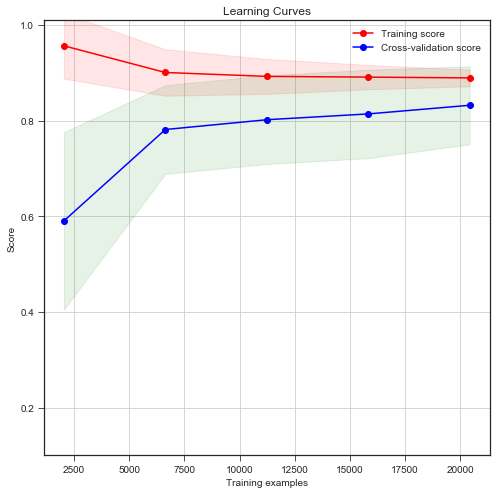

In [103]:
# Cross validation with 10 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)


steps = {"preprocessor" : preprocessor}
im_pipe_pre_process = add_to_pipeline(**steps)
estimator = CV_grid_model.best_estimator_.get_params()['classifier']
title = r"Learning Curves"
plot_learning_curve(estimator, title, im_pipe_pre_process.fit_transform(X_train), y_train, 
                       (0.1, 1.01), cv=cv, n_jobs=-1)

In [104]:
y_pred = evaluate_model(CV_grid_model, X_train, y_train)
y_pred

Accuracy score : 0.6476578411405295
classification_report :
                precision    recall  f1-score   support

           No     0.1428    0.6109    0.2314      1663
          Yes     0.0467    0.8750    0.0887       136
indeterminate     0.9706    0.6489    0.7778     23733

    micro avg     0.6477    0.6477    0.6477     25532
    macro avg     0.3867    0.7116    0.3660     25532
 weighted avg     0.9118    0.6477    0.7386     25532



array(['Yes', 'Yes', 'Yes', ..., 'No', 'Yes', 'indeterminate'],
      dtype=object)

### Validate on test set

In [105]:
salesReportDataTrain_share_feature_to_test.head()
salesReportDataTrain_share_feature_to_test.dtypes

,SalesPersonID,ProductID,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID
0,C22230,PR6246,172910,26911,6.425254,546690,106552,5.130734,16290,549,29.672131
4,C22230,PR6115,9453585,1883862,5.018194,546690,106552,5.130734,57135,9987,5.720937
8,C22230,PR6116,2129325,356272,5.976684,546690,106552,5.130734,76860,12912,5.952602
11,C22230,PR6207,2915255,636709,4.578630,546690,106552,5.130734,383230,82186,4.662960
18,C22230,PR6128,15345,1172,13.093003,546690,106552,5.130734,13175,918,14.351852


SalesPersonID                            object
ProductID                                object
TotalSalesValueByProduct                  int64
QuantityByProduct                         int64
AverageSalesValueByProduct              float64
TotalSalesValueBySalesMan                 int64
QuantityBySalesMan                        int64
AverageSalesValueBySalesMan             float64
TotalSalesValueBySalesManProductID        int64
QuantityBySalesManProductID               int64
AverageSalesValueBySalesManProductID    float64
dtype: object

In [106]:
# Get Average Product selling price per SalesPersonID.  This is to fill misiing values for ProductID
salesReportDataTrain_share_feature_to_test_grp_by_SalesPersonID_avg = salesReportDataTrain_share_feature_to_test.groupby(
    'SalesPersonID').mean()
salesReportDataTrain_share_feature_to_test_grp_by_SalesPersonID_avg.head()
salesReportDataTrain_share_feature_to_test_grp_by_SalesPersonID_avg.shape


# Get Average Product selling price per ProductID, across SalesPersonID. This is to fill misiing values for SalesPersonID
salesReportDataTrain_share_feature_to_test_grp_by_ProductID_avg = salesReportDataTrain_share_feature_to_test.groupby(
    'ProductID').mean()
salesReportDataTrain_share_feature_to_test_grp_by_ProductID_avg.head()
salesReportDataTrain_share_feature_to_test_grp_by_ProductID_avg.shape


,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID
SalesPersonID,,,,,,,,,
C21116,3.980108e+06,331635.000000,15.956549,15820.0,1288.0,12.282609,5.273333e+03,429.333333,13.141504
C21118,1.650275e+06,795119.000000,2.075507,1583390.0,764085.0,2.072269,1.583390e+06,764085.000000,2.072269
C21119,4.417961e+06,415665.333333,8.361214,3665.0,368.0,9.959239,1.221667e+03,122.666667,10.236755
C21121,2.502879e+06,329053.285714,7.393498,166590.0,12926.0,12.887978,2.379857e+04,1846.571429,14.328986
C21122,3.341280e+06,276850.000000,12.514368,31405.0,3569.0,8.799384,7.851250e+03,892.250000,9.366196


(986, 9)

,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID
ProductID,,,,,,,,,
PR6112,867970.0,79675.0,10.893881,1.222967e+06,105771.478261,12.055799,37737.826087,3464.130435,12.979367
PR6113,92555.0,2485.0,37.245473,3.137017e+05,39891.333333,6.732399,30851.666667,828.333333,32.978347
PR6114,789600.0,248494.0,3.177542,5.915242e+05,166502.500000,3.674058,131600.000000,41415.666667,4.177016
PR6115,9453585.0,1883862.0,5.018194,1.391226e+06,231941.649123,7.367555,165852.368421,33050.210526,7.680841
PR6116,2129325.0,356272.0,5.976684,1.175526e+06,132948.703704,9.458960,39431.944444,6597.629630,10.290341


(590, 9)

In [107]:
#Get the required datset from train data to be mapped with test data for derived columns
salesReportDataTrain_share_feature_to_test_by_product = salesReportDataTrain_share_feature_to_test[
    ['ProductID', 'TotalSalesValueByProduct','QuantityByProduct', 
     'AverageSalesValueByProduct']].drop_duplicates()
salesReportDataTrain_share_feature_to_test_by_product.shape
salesReportDataTrain_share_feature_to_test_by_product.head()

salesReportDataTrain_share_feature_to_test_by_salesMan = salesReportDataTrain_share_feature_to_test[
    ['SalesPersonID', 'TotalSalesValueBySalesMan','QuantityBySalesMan', 
     'AverageSalesValueBySalesMan']].drop_duplicates()
salesReportDataTrain_share_feature_to_test_by_salesMan.shape
salesReportDataTrain_share_feature_to_test_by_salesMan.head()

salesReportDataTrain_share_feature_to_test_by_product_salesMan = salesReportDataTrain_share_feature_to_test[
    ['SalesPersonID','ProductID', 'TotalSalesValueBySalesManProductID','QuantityBySalesManProductID',
     'AverageSalesValueBySalesManProductID']].drop_duplicates()
salesReportDataTrain_share_feature_to_test_by_product_salesMan.shape
salesReportDataTrain_share_feature_to_test_by_product_salesMan.head()


(590, 4)

,ProductID,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct
0,PR6246,172910,26911,6.425254
4,PR6115,9453585,1883862,5.018194
8,PR6116,2129325,356272,5.976684
11,PR6207,2915255,636709,4.578630
18,PR6128,15345,1172,13.093003


(986, 4)

,SalesPersonID,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan
0,C22230,546690,106552,5.130734
19,C21899,294945,35194,8.380548
61,C21284,35225,3320,10.609940
84,C22015,63975,20104,3.182203
88,C22159,31630,1588,19.918136


(6731, 5)

,SalesPersonID,ProductID,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID
0,C22230,PR6246,16290,549,29.672131
4,C22230,PR6115,57135,9987,5.720937
8,C22230,PR6116,76860,12912,5.952602
11,C22230,PR6207,383230,82186,4.662960
18,C22230,PR6128,13175,918,14.351852


In [108]:
salesReportDataTest.head()
salesReportDataTest.shape

,ReportID,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious
24344,Rep34445,C22046,PR6393,238,2415,indeterminate
33706,Rep43807,C21938,PR6381,120,6810,indeterminate
23342,Rep33443,C21980,PR6227,133,1835,indeterminate
10983,Rep21084,C22335,PR6278,112,1490,indeterminate
12505,Rep22606,C21178,PR6347,2140,8760,indeterminate


(10646, 6)

In [109]:
#Drop ReportID column, as in case of train
salesReportDataTest_dropped_attr_no_dup = salesReportDataTest.drop(['ReportID'], axis=1)

#Add the SalesValuePerItem column
salesReportDataTest_dropped_attr_no_dup.insert(5, 'SalesValuePerItem', 
                                          salesReportDataTest_dropped_attr_no_dup['TotalSalesValue']/salesReportDataTest_dropped_attr_no_dup['Quantity'])

#Left join here, as the distinct ProductID in train may not be same as in test
salesReportDataTest_dropped_attr_no_dup_P = salesReportDataTest_dropped_attr_no_dup.merge(
    salesReportDataTrain_share_feature_to_test_by_product, on='ProductID', how='left')

salesReportDataTest_dropped_attr_no_dup_P_S = salesReportDataTest_dropped_attr_no_dup_P.merge(
    salesReportDataTrain_share_feature_to_test_by_salesMan, on='SalesPersonID', how='left')

salesReportDataTest_dropped_attr_no_dup_P_and_S = salesReportDataTest_dropped_attr_no_dup_P_S.merge(
    salesReportDataTrain_share_feature_to_test_by_product_salesMan, on=['SalesPersonID', 'ProductID'], how='left')

salesReportDataTest_dropped_attr_no_dup_P_and_S.head()
salesReportDataTest_dropped_attr_no_dup_P_and_S.shape
salesReportDataTest_dropped_attr_no_dup_P_and_S.dtypes

,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious,SalesValuePerItem,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID
0,C22046,PR6393,238,2415,indeterminate,10.147059,231520.0,17446.0,13.270664,350705.0,24324.0,14.418064,17015.0,1576.0,10.796320
1,C21938,PR6381,120,6810,indeterminate,56.750000,855100.0,34347.0,24.895915,1982065.0,33696.0,58.821967,303565.0,5527.0,54.924009
2,C21980,PR6227,133,1835,indeterminate,13.796992,1033308.0,117056.0,8.827467,220340.0,39634.0,5.559368,2460.0,368.0,6.684783
3,C22335,PR6278,112,1490,indeterminate,13.303571,1264350.0,104988.0,12.042805,735380.0,53365.0,13.780193,2760.0,207.0,13.333333
4,C21178,PR6347,2140,8760,indeterminate,4.093458,1077990.0,215738.0,4.996755,20697775.0,5822616.0,3.554721,724965.0,150453.0,4.818548


(10646, 15)

SalesPersonID                            object
ProductID                                object
Quantity                                  int64
TotalSalesValue                           int64
Suspicious                               object
SalesValuePerItem                       float64
TotalSalesValueByProduct                float64
QuantityByProduct                       float64
AverageSalesValueByProduct              float64
TotalSalesValueBySalesMan               float64
QuantityBySalesMan                      float64
AverageSalesValueBySalesMan             float64
TotalSalesValueBySalesManProductID      float64
QuantityBySalesManProductID             float64
AverageSalesValueBySalesManProductID    float64
dtype: object

In [110]:
x=salesReportDataTest_dropped_attr_no_dup_P_and_S.drop([
              'TotalSalesValueBySalesManProductID', 'QuantityBySalesManProductID', 'AverageSalesValueBySalesManProductID'], axis=1)
x[x.isnull().any(axis=1)].head()

,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious,SalesValuePerItem,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan
9,C22030,PR6122,655,3950,No,6.030534,NaN,NaN,NaN,14529685.0,3890725.0,3.734442
99,C22314,PR6257,2816,20995,indeterminate,7.455611,340835.0,151972.0,2.242749,NaN,NaN,NaN
1380,C22222,PR6428,198,3365,indeterminate,16.994949,NaN,NaN,NaN,80740.0,7796.0,10.356593
1904,C21625,PR6430,6211,17740,indeterminate,2.856223,NaN,NaN,NaN,2171605.0,2609471.0,0.832201
3849,C22083,PR6116,1308,19100,No,14.602446,2129325.0,356272.0,5.976684,NaN,NaN,NaN


In [111]:
'''
It means these product are not present in train data
Replace the Missing value with avg of other product details for the same salePerson.
This way it fills up value with the trend of sales by the salesman.
'''
salesReportDataTest_dropped_attr_no_dup_P_and_S.loc[
    salesReportDataTest_dropped_attr_no_dup_P_and_S.TotalSalesValueByProduct.isnull(), 
    'TotalSalesValueByProduct'] = salesReportDataTest_dropped_attr_no_dup_P_and_S[
    'SalesPersonID'].map(salesReportDataTrain_share_feature_to_test_grp_by_SalesPersonID_avg.TotalSalesValueBySalesMan)

salesReportDataTest_dropped_attr_no_dup_P_and_S.loc[
    salesReportDataTest_dropped_attr_no_dup_P_and_S.QuantityByProduct.isnull(), 
    'QuantityByProduct'] = salesReportDataTest_dropped_attr_no_dup_P_and_S[
    'SalesPersonID'].map(salesReportDataTrain_share_feature_to_test_grp_by_SalesPersonID_avg.QuantityBySalesMan)

salesReportDataTest_dropped_attr_no_dup_P_and_S.loc[
    salesReportDataTest_dropped_attr_no_dup_P_and_S.AverageSalesValueByProduct.isnull(), 
    'AverageSalesValueByProduct'] = salesReportDataTest_dropped_attr_no_dup_P_and_S[
    'SalesPersonID'].map(salesReportDataTrain_share_feature_to_test_grp_by_SalesPersonID_avg.AverageSalesValueBySalesMan)




'''
It means these salesman are not present in train data
Replace the Missing value with avg of other salesman details for the diff salePerson, selling the same product
This way it fills up value with the trend of sales for the same product.
'''

salesReportDataTest_dropped_attr_no_dup_P_and_S.loc[
    salesReportDataTest_dropped_attr_no_dup_P_and_S.TotalSalesValueBySalesMan.isnull(), 
    'TotalSalesValueBySalesMan'] = salesReportDataTest_dropped_attr_no_dup_P_and_S[
    'ProductID'].map(salesReportDataTrain_share_feature_to_test_grp_by_ProductID_avg.TotalSalesValueByProduct)

salesReportDataTest_dropped_attr_no_dup_P_and_S.loc[
    salesReportDataTest_dropped_attr_no_dup_P_and_S.QuantityBySalesMan.isnull(), 
    'QuantityBySalesMan'] = salesReportDataTest_dropped_attr_no_dup_P_and_S[
    'ProductID'].map(salesReportDataTrain_share_feature_to_test_grp_by_ProductID_avg.QuantityByProduct)

salesReportDataTest_dropped_attr_no_dup_P_and_S.loc[
    salesReportDataTest_dropped_attr_no_dup_P_and_S.AverageSalesValueBySalesMan.isnull(), 
    'AverageSalesValueBySalesMan'] = salesReportDataTest_dropped_attr_no_dup_P_and_S[
    'ProductID'].map(salesReportDataTrain_share_feature_to_test_grp_by_ProductID_avg.AverageSalesValueByProduct)


#It means these salesman & ProductID combination is not present in train data


'\nIt means these product are not present in train data\nReplace the Missing value with avg of other product details for the same salePerson.\nThis way it fills up value with the trend of sales by the salesman.\n'

'\nIt means these salesman are not present in train data\nReplace the Missing value with avg of other salesman details for the diff salePerson, selling the same product\nThis way it fills up value with the trend of sales for the same product.\n'

In [112]:
x=salesReportDataTest_dropped_attr_no_dup_P_and_S.drop([
              'TotalSalesValueBySalesManProductID', 'QuantityBySalesManProductID', 'AverageSalesValueBySalesManProductID'], axis=1)
x[x.isnull().any(axis=1)]

,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious,SalesValuePerItem,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan


In [113]:
# Derive variation columns
salesReportDataTest_dropped_attr_no_dup_P_and_S['SalesValuePerItemVariationFromAvgProduct'] = (((salesReportDataTest_dropped_attr_no_dup_P_and_S['AverageSalesValueByProduct'] - 
 salesReportDataTest_dropped_attr_no_dup_P_and_S['SalesValuePerItem']).abs())/salesReportDataTest_dropped_attr_no_dup_P_and_S['AverageSalesValueByProduct'])*100

salesReportDataTest_dropped_attr_no_dup_P_and_S['perc_Quantity_by_Product'] = (
    salesReportDataTest_dropped_attr_no_dup_P_and_S['Quantity']/salesReportDataTest_dropped_attr_no_dup_P_and_S['QuantityByProduct'])*100

salesReportDataTest_dropped_attr_no_dup_P_and_S['SalesValuePerItemVariationFromAvgSalesMan'] = (((salesReportDataTest_dropped_attr_no_dup_P_and_S['AverageSalesValueBySalesMan'] - 
 salesReportDataTest_dropped_attr_no_dup_P_and_S['SalesValuePerItem']).abs())/salesReportDataTest_dropped_attr_no_dup_P_and_S['AverageSalesValueBySalesMan'])*100

salesReportDataTest_dropped_attr_no_dup_P_and_S['perc_Quantity_by_SalesMan'] = (
    salesReportDataTest_dropped_attr_no_dup_P_and_S['Quantity']/salesReportDataTest_dropped_attr_no_dup_P_and_S['QuantityBySalesMan'])*100


salesReportDataTest_dropped_attr_no_dup_P_and_S['SalesValuePerItemVariationFromAvgSalesManProductID'] = (((salesReportDataTest_dropped_attr_no_dup_P_and_S['AverageSalesValueBySalesManProductID'] - 
 salesReportDataTest_dropped_attr_no_dup_P_and_S['SalesValuePerItem']).abs())/salesReportDataTest_dropped_attr_no_dup_P_and_S['AverageSalesValueBySalesManProductID'])*100

salesReportDataTest_dropped_attr_no_dup_P_and_S['perc_Quantity_by_SalesMan_ProductID'] = (
    salesReportDataTest_dropped_attr_no_dup_P_and_S['Quantity']/salesReportDataTest_dropped_attr_no_dup_P_and_S['QuantityBySalesManProductID'])*100


salesReportDataTest_dropped_attr_no_dup_P_and_S.head()
salesReportDataTest_dropped_attr_no_dup_P_and_S.dtypes
salesReportDataTest_dropped_attr_no_dup_P_and_S.shape

,SalesPersonID,ProductID,Quantity,TotalSalesValue,Suspicious,SalesValuePerItem,TotalSalesValueByProduct,QuantityByProduct,AverageSalesValueByProduct,TotalSalesValueBySalesMan,QuantityBySalesMan,AverageSalesValueBySalesMan,TotalSalesValueBySalesManProductID,QuantityBySalesManProductID,AverageSalesValueBySalesManProductID,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,SalesValuePerItemVariationFromAvgSalesMan,perc_Quantity_by_SalesMan,SalesValuePerItemVariationFromAvgSalesManProductID,perc_Quantity_by_SalesMan_ProductID
0,C22046,PR6393,238,2415,indeterminate,10.147059,231520.0,17446.0,13.270664,350705.0,24324.0,14.418064,17015.0,1576.0,10.796320,23.537669,1.364210,29.622601,0.978457,6.013725,15.101523
1,C21938,PR6381,120,6810,indeterminate,56.750000,855100.0,34347.0,24.895915,1982065.0,33696.0,58.821967,303565.0,5527.0,54.924009,127.949041,0.349375,3.522437,0.356125,3.324576,2.171160
2,C21980,PR6227,133,1835,indeterminate,13.796992,1033308.0,117056.0,8.827467,220340.0,39634.0,5.559368,2460.0,368.0,6.684783,56.296163,0.113621,148.175547,0.335570,106.394034,36.141304
3,C22335,PR6278,112,1490,indeterminate,13.303571,1264350.0,104988.0,12.042805,735380.0,53365.0,13.780193,2760.0,207.0,13.333333,10.469044,0.106679,3.458744,0.209875,0.223214,54.106280
4,C21178,PR6347,2140,8760,indeterminate,4.093458,1077990.0,215738.0,4.996755,20697775.0,5822616.0,3.554721,724965.0,150453.0,4.818548,18.077679,0.991944,15.155536,0.036753,15.047895,1.422371


SalesPersonID                                          object
ProductID                                              object
Quantity                                                int64
TotalSalesValue                                         int64
Suspicious                                             object
SalesValuePerItem                                     float64
TotalSalesValueByProduct                              float64
QuantityByProduct                                     float64
AverageSalesValueByProduct                            float64
TotalSalesValueBySalesMan                             float64
QuantityBySalesMan                                    float64
AverageSalesValueBySalesMan                           float64
TotalSalesValueBySalesManProductID                    float64
QuantityBySalesManProductID                           float64
AverageSalesValueBySalesManProductID                  float64
SalesValuePerItemVariationFromAvgProduct              float64
perc_Qua

(10646, 21)

In [114]:
col_to_drop = ['SalesPersonID', 'ProductID', 
               'TotalSalesValueByProduct', 'QuantityByProduct', 'AverageSalesValueByProduct',
               'TotalSalesValueBySalesMan', 'QuantityBySalesMan', 'AverageSalesValueBySalesMan',
              'TotalSalesValueBySalesManProductID', 'QuantityBySalesManProductID', 'AverageSalesValueBySalesManProductID',
              'SalesValuePerItemVariationFromAvgSalesManProductID', 'perc_Quantity_by_SalesMan_ProductID']
salesReportDataTest_dropped_attr_no_dup_P_and_S_col_fillter = salesReportDataTest_dropped_attr_no_dup_P_and_S.drop(
    col_to_drop, axis=1)
salesReportDataTest_dropped_attr_no_dup_P_and_S_col_fillter.head()
salesReportDataTest_dropped_attr_no_dup_P_and_S_col_fillter.shape
salesReportDataTest_dropped_attr_no_dup_P_and_S_col_fillter.dtypes

,Quantity,TotalSalesValue,Suspicious,SalesValuePerItem,SalesValuePerItemVariationFromAvgProduct,perc_Quantity_by_Product,SalesValuePerItemVariationFromAvgSalesMan,perc_Quantity_by_SalesMan
0,238,2415,indeterminate,10.147059,23.537669,1.364210,29.622601,0.978457
1,120,6810,indeterminate,56.750000,127.949041,0.349375,3.522437,0.356125
2,133,1835,indeterminate,13.796992,56.296163,0.113621,148.175547,0.335570
3,112,1490,indeterminate,13.303571,10.469044,0.106679,3.458744,0.209875
4,2140,8760,indeterminate,4.093458,18.077679,0.991944,15.155536,0.036753


(10646, 8)

Quantity                                       int64
TotalSalesValue                                int64
Suspicious                                    object
SalesValuePerItem                            float64
SalesValuePerItemVariationFromAvgProduct     float64
perc_Quantity_by_Product                     float64
SalesValuePerItemVariationFromAvgSalesMan    float64
perc_Quantity_by_SalesMan                    float64
dtype: object

In [118]:
# Datatype conversions
salesReportDataTest_dropped_attr_no_dup_P_and_S_col_fillter[cat_col] = covert_var(salesReportDataTest_dropped_attr_no_dup_P_and_S_col_fillter[cat_col], "cat")
salesReportDataTest_dropped_attr_no_dup_P_and_S_col_fillter[num_col] = covert_var(salesReportDataTest_dropped_attr_no_dup_P_and_S_col_fillter[num_col], "num_float")    

X_test = salesReportDataTest_dropped_attr_no_dup_P_and_S_col_fillter.drop('Suspicious', axis=1)
y_test = salesReportDataTest_dropped_attr_no_dup_P_and_S_col_fillter['Suspicious']

y_test_pred = evaluate_model(CV_grid_model, X_test, y_test)
y_test_pred

Accuracy score : 0.6441856096186361
classification_report :
                precision    recall  f1-score   support

           No     0.1285    0.5728    0.2099       639
          Yes     0.0345    0.8889    0.0664        45
indeterminate     0.9718    0.6477    0.7773      9962

    micro avg     0.6442    0.6442    0.6442     10646
    macro avg     0.3783    0.7031    0.3512     10646
 weighted avg     0.9173    0.6442    0.7402     10646



array(['indeterminate', 'No', 'indeterminate', ..., 'indeterminate', 'No',
       'indeterminate'], dtype=object)

[[ 366   89  184]
 [   2   40    3]
 [2480 1030 6452]]


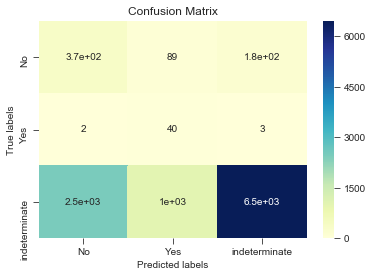

In [119]:
plot_confusion_matrix(y_test,y_test_pred)